<div style="text-align: center;">
  <img src="images/logo UniversiData_hor_black.png" alt="logo UniversiData_hor_black.png" style="max-width: 100%;">
</div>

<div style="border: 2px solid #000; border-radius: 8px; padding: 15px; background-color: #fff; color: #000;">

<center>
<font size=5> Welcome to the 2025 Hackathon! </font>
</center>

<center>
<img src="https://github.githubassets.com/images/modules/logos_page/GitHub-Mark.png" alt="GitHub" width="14"> Link to documentation and data: <a href="https://github.com/Universidata-srl/hackathon">github.com/Universidata-srl/hackathon</a>
</center>

#### <u>Overview</u> <a class="tocSkip">

In this Hackathon you will be required to estimate the **value** of a building with respect to the possibility of installing **solar panels** on it.

You will be given **satellite images**, and you will have to **detect** all buildings and then **predict** their value. 

#### <u>Objective</u> <a class="tocSkip">

Your technical objective is two-fold:

> `objective 1` : detect as many as possible **true** buildings in the <u>test</u> area

> `objective 2` : **correctly predict** the values of the detected buildings in the <u>test</u> area

#### <u>Winning criteria</u> <a class="tocSkip">

Your **score** will be evaluated as a _weighted average_ of the scores by a **technical** and a **business** panel:

$$ \text{final score} = 60\%~\text{technical score} + 40\%~\text{business score}$$

**Technical score [max: 1 point]**

The technical score relates to the **performance** of your code $-$ You can collect points in this way:

- `+0.3 points` : You detected more than **35% of the true buildings** in the test area
- `+0.3 points` : Your prediction model scores a **Mean Squared Error (MSE)** lower than 2.0 on the test area
- `+0.2 points` : You detected more **true buildings** than the other participants
- `+0.2 points` : Your prediction model scores a **better MSE** than the other participants

**Business score [max: 1 point]**

The business score relates to the **presentation** of your project $-$ Your presentation shall address:
- a brief explanation of the technical solution
- how can the analysis can be exploited in buisiness context

#### <u>Working groups</u> <a class="tocSkip">

You will work in **groups** (8/10 people), each group competeing for the victory as a whole.

- Each team shall be comprised by an equal amount of participants from the **begineer**, **intermediate**, and **advanced** classes
- Each team shall elect a **group leader**


</div>
<br>

In [3]:
# Import hackathon data
import os

# check if data directory exists
if not os.path.exists("/content/data"):
    print("data dir not found, cloning repo...")
    !git clone https://github.com/gitpeblo/hackathon.git
    !mv hackathon/data .
    !mv hackathon/images .    
    !rm -rf hackathon
    !rm -rf sample_data
else:
    print("data directory already exists")

data dir not found, cloning repo...
Cloning into 'hackathon'...
remote: Enumerating objects: 49, done.
remote: Counting objects: 100% (23/23), done.
remote: Compressing objects: 100% (16/16), done.
remote: Total 49 (delta 12), reused 16 (delta 7), pack-reused 26 (from 1)
Receiving objects: 100% (49/49), 25.39 MiB | 33.13 MiB/s, done.
Resolving deltas: 100% (21/21), done.
mv: cannot overwrite './data': Directory not empty
mv: cannot overwrite './images': Directory not empty


# Let's look at the data

The data is obtained from a satelite image from a section of the city of **Boston**:

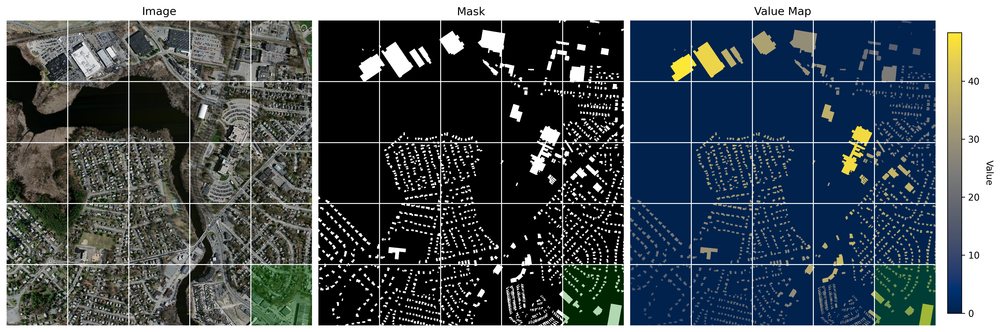

In [4]:
from IPython.display import Image
Image(filename="images/image_mask_map.png")

## What are these data?

- _Left_ $-$ The satelite **image**
- _Center_ $-$ The **mask** showing the ground-truth location of all the buildings
- _Right_ $-$ The **value map**, showing how important is each building for the installation of solar panels

As you can see, we segmented these images on a grid of $5 \times 5 = 25$ splits: we will call them "**samples**".

- The first 24 samples will constitute your **training data**
- The last 1 sample will constitute your **test data** (_highlighted in green_)

Let's **load all samples** and look at a few of them:

5 examples [out of 24] of training areas/masks/maps:


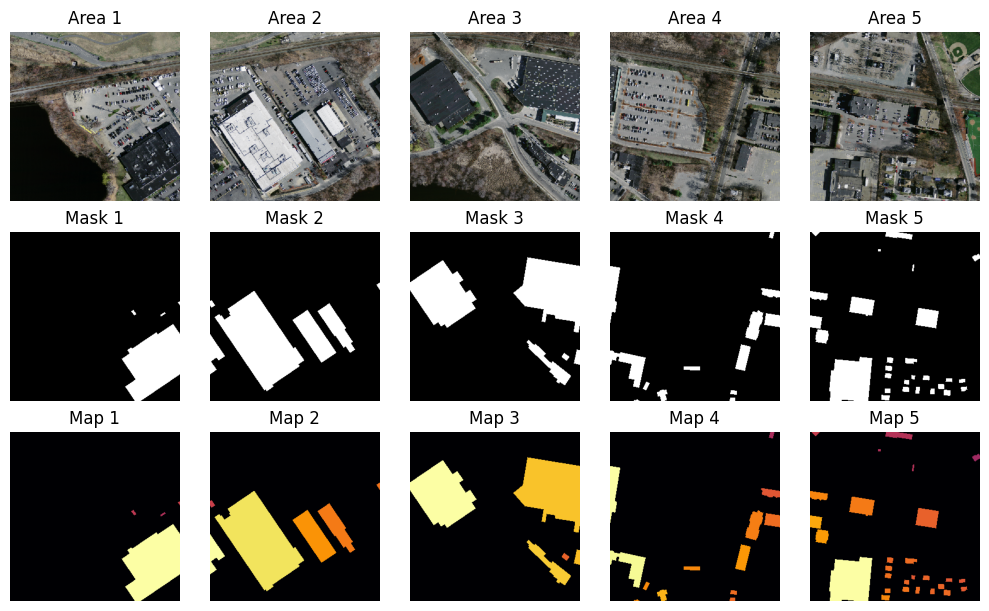



Dataframe of ground truth patches: each row is a patch in any of the images


,image_ID,patch_ID,centroid_x,centroid_y,patch_area,bbox,value
0,0,1,269.333333,146.466667,30.0,"(143, 265, 151, 275)",22.932174
1,0,2,217.953488,143.604651,43.0,"(139, 214, 149, 223)",24.711937
2,0,3,298.133333,126.600000,15.0,"(124, 296, 131, 300)",26.183018
3,0,4,253.434126,232.372484,8744.0,"(164, 197, 300, 300)",48.327791
4,1,1,3.054054,128.459459,74.0,"(122, 0, 135, 9)",26.183018
...,...,...,...,...,...,...,...
1359,23,137,295.182796,294.698925,93.0,"(286, 288, 300, 300)",33.782497
1360,23,138,1.982456,15.649123,57.0,"(10, 0, 24, 7)",35.016672
1361,23,139,83.828341,57.513249,1736.0,"(18, 43, 91, 121)",36.517404
1362,23,140,293.501425,147.059829,351.0,"(129, 282, 167, 300)",38.099080




Test image on which to infer the patch values:


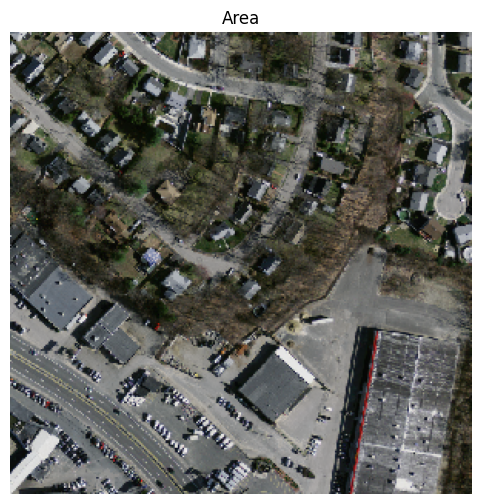

In [5]:
import pickle
from matplotlib import pyplot as plt

# === Load the bundle ===
with open("data/bundle_participants.pkl", "rb") as f:
    bundle_participants = pickle.load(f)

# Train set
X_train_areas = bundle_participants["X_train_areas"]
X_train_msks  = bundle_participants["X_train_msks"]
X_train_maps  = bundle_participants["X_train_maps"]
df_train      = bundle_participants["df_train"]

# Test set
X_test_area = bundle_participants["X_test_area"]


# === Display 5 examples of training areas / masks / maps ===

print(f'5 examples [out of {len(X_train_areas)}] of training areas/masks/maps:')

fig, axes = plt.subplots(3, 5, figsize=(10, 6), constrained_layout=True)

# --- first 5 areas ---
for i in range(5):
    axes[0, i].imshow(X_train_areas[i])
    axes[0, i].set_title(f"Area {i+1}")
    axes[0, i].axis("off")
    axes[0, i].set_aspect("equal")

# --- first 5 masks ---
for i in range(5):
    axes[1, i].imshow(X_train_msks[i], cmap="gray")
    axes[1, i].set_title(f"Mask {i+1}")
    axes[1, i].axis("off")
    axes[1, i].set_aspect("equal")

# --- first 5 maps ---
for i in range(5):
    axes[2, i].imshow(X_train_maps[i], cmap="inferno")
    axes[2, i].set_title(f"Map {i+1}")
    axes[2, i].axis("off")
    axes[2, i].set_aspect("equal")

plt.show()

# === Show dataframe of ground truth segments ===
print('\n\nDataframe of ground truth patches: each row is a patch in any of the images')
display(df_train)


# === Test image on which to infer the patch values ===
print('\n\nTest image on which to infer the patch values:')
fig = plt.figure(figsize=(6, 6))

plt.title(f"Area")
plt.imshow(X_test_area)
plt.axis("off")
plt.show()

## What do you receive?

The code above has **already** loaded the following variables:

```python
    X_train_areas = bundle_participants["X_train_areas"]
    X_train_msks  = bundle_participants["X_train_msks"]
    X_train_maps  = bundle_participants["X_train_maps"]
    df_train      = bundle_participants["df_train"]
```

```python
    X_test_area = bundle_participants["X_test_area"]
```

**Train:**
- `X_train_areas` : list containing the 24 area images
- `X_train_msks` : list containing the 24 pixel masks [0 or 1]
- `X_train_maps` : list containing the 24 value maps [each building has a different value]
- `df_train`: dataframe containing the **true** building values for each building patch of pixels

| Column         | Description                                                                                   |
|----------------|-----------------------------------------------------------------------------------------------|
| `image_ID`     | Index of the sample image from which the patch was extracted (0–23).                          |
| `patch_ID`     | Identifier of the building patch within that image.                                           |
| `centroid_x`   | X-coordinate of the patch centroid.                                                           |
| `centroid_y`   | Y-coordinate of the patch centroid.                                                           |
| `patch_area`   | Number of pixels belonging to the patch.                                                      |
| `bbox`         | Bounding box of the patch in the format `(ymin, xmin, ymax, xmax)`.                           |
| `value`        | Value associated with the building.                                                           |

**Test:**
- `X_test_area` : test area image


<div style="border-left: 5px solid #FFA500; background-color: rgba(255, 165, 0, 0.15); padding: 10px; border-radius: 4px; color: inherit;">

## Task

You will have to complete the following tasks.
<br><br>

#### Task 1 $-$ Building segmentation
> [ intermediate/advanced participants ]

Use computer vision to detect and characterize all the buildings.

1. Use **SAM** (**Segment Anything Model**) to find all the buildings in the images<br>
   &emsp;&emsp;(_You may post process the segmentation to remove false detections if needed_)
   
2. For each patch, **associate** a corresponding `value` from the training value maps<br>
   &emsp;&emsp;(_e.g., you can use the value of the closest true building_)

3. **Create a dataframe** `df_segmentations`, with the same columns as `df_train`, but:

   - replace the entries with the results you obtained from **steps 1.** and **2.**
   - include new rows for the patches in the **test set**

| image_ID | patch_ID | centroid_x | centroid_y | patch_area | bbox                     | value |
|----------|----------|------------|------------|------------|---------------------------|-------|
| …        | …        | …          | …          | …          | (…, …, …, …)              | …     |
| …        | …        | …          | …          | …          | (…, …, …, …)              | …     |

**Important:** This dataframe shall also contain the data for the **test** image $-$ For those, you shall set the `value` to 0 since this is unknown for the test.
<br><br>

#### Task 2 $-$ Regression
>  [ beginner/intermediate participants ]

Train a regression model on `df_segmentations`, that uses any sub-set of the columns to predict column `value`.

**Hint:** You will receive `df_segmentations` from Task 1, but, until your team mates are done, you can use `df_train`, since it has exactly the same structure.<br>
&emsp;&emsp; Just remember to drop any row pertaining to the test set!
</div>
<br>

<div style="border: 2px solid #000; border-radius: 8px; padding: 15px; background-color: #fff; color: #000;">

## Evaluation

We will evaluate as follows:

**Task 1**: We will check how many bounding boxes match with the ground truth, for the test image.

**Task 2**: We will apply your trained model to the dataframe, and evaluate the MSE.

## Expected outputs

> Send you results to $\texttt{amministrazione@universidata.it}$ with subject ''<span style="color: #267599;">Hacathon 2025 - \<group_name\></span>''

💾 **your code**

- Notebooks/files $-$ this is for us to check your logic

💾 **image**

- An image showing the **overlay** or **mask** of all segmentations detected on the test image, named "$\texttt{segmentations.png}$"

💾 **dataset**

- The dataset `df_segmentations` shall be sent as a $\texttt{.csv}$ file named "**$\texttt{df}$_$\texttt{segmentations.csv}$**"
- It shall have exactly and only the columns mentioned above

💾 **trained model**

- The trained model shall be sent to us as a `joblib` file named "**$\texttt{model.pkl}$**"

    <span style="color: #00aa00; font-weight: bold;">import</span> joblib<br>
    joblib.<span style="color: #267599;">dump</span>(model, <span style="color: #cc0000;">"model.pkl"</span>)

- **Write us which features** of `df_segmentation` you used, e.g.:

    [<span style="color: #cc0000;">"patch_ID"</span>, <span style="color: #cc0000;">"centroid_x"</span>, <span style="color: #cc0000;">"patch_area"</span>]
    
  We will extract the features from a test dataframe with the same columns as `df_segmentation` $\rightarrow$  you need to make sure that we can just run:
     
    X_test = df_test[[<span style="color: #cc0000;">"patch_ID"</span>, <span style="color: #cc0000;">"centroid_x"</span>, <span style="color: #cc0000;">"patch_area"</span>]]<br>
    model.<span style="color: #267599;">predict</span>(X_test)

</div>
<br>

<div class="alert alert-danger" role="alert" style="border-radius: 8px; padding: 10px;">
    
⚠️ **Warning** ⚠️ 

For the evaluation to happen, it is <u>**fundamental**</u> that you pass us your results in the correct format.

We will <u>not</u> be able to debug your code! $\rightarrow$ Make sure you comply to these formats!

</div>

In [6]:
'''
This block installs the necessary packages for SAM (Segment Anything Model)
But, feel free to use any other segmentation model you would like!
''';
import importlib
import subprocess
import sys

def ensure(module, pip_name=None):
    try:
        importlib.import_module(module)
        print(f"{module} already installed")
    except ImportError:
        print(f"{module} missing, installing...")
        if pip_name is None:
            pip_name = module
        subprocess.check_call([sys.executable, "-m", "pip", "install", pip_name])

# Check and install basic packages - torch first
ensure("torch")
ensure("torchvision")
ensure("cv2", "opencv-python")

# Check and install SAM
try:
    import segment_anything
    print("segment-anything already installed")
except ImportError:
    print("segment-anything missing, installing...")
    !pip install git+https://github.com/facebookresearch/segment-anything.git

torch already installed
torchvision already installed
cv2 already installed
segment-anything already installed


In [7]:
# good luck, have fun coding!

<div class="alert alert-danger" role="alert" style="border-radius: 8px; padding: 10px;">
    
**Solution below**

</div>

# Setup

In [8]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

# Set seaborn style
sns.set_theme(style="darkgrid")  # Options: "white", "dark", "whitegrid", "darkgrid", "ticks"

# Global settings for Matplotlib
plt.rcParams.update({
    "figure.figsize": (8, 4),   # Default figure size (width, height)
    "axes.titlesize": 14,       # Title font size
    "axes.labelsize": 12,       # Label font size
    "xtick.labelsize": 10,      # X-axis tick font size
    "ytick.labelsize": 10,      # Y-axis tick font size
    "legend.fontsize": 10,      # Legend font size
    "font.size": 10,            # General font size
    "figure.autolayout": True,  # Auto-layout for better spacing
    "axes.grid": True,          # Show grid
    "grid.alpha": 0.3,          # Grid transparency
    "lines.linewidth": 2,       # Default line width
    "lines.markersize": 6,      # Default marker size
    "figure.dpi": 100,          # Resolution of figures
    "savefig.dpi": 300,         # Resolution for saved figures
    "axes.spines.top": False,   # Remove top spine
    "axes.spines.right": False, # Remove right spine
    "text.color": "gray",   # Set all text color
    "axes.labelcolor": "gray",  # Set axis labels color
    "xtick.color": "gray",  # Set x-axis tick labels color
    "ytick.color": "gray",  # Set y-axis tick labels color
    "legend.edgecolor": "gray",  # Set legend edge color
    "legend.labelcolor": "gray"  # Set legend text color    
})

In [9]:
from pathlib import Path

path_results = "results"
Path(path_results).mkdir(parents=True, exist_ok=True)
print(f"Folder ensured: {path_results}")

Folder ensured: results


<font size=10> Solution part 1 - Find buildings using segmentation </font>

**Tasks:**
1. Segment the images into **patches** _(one patch per building inside each area image_)
2. Create a **dataset** of patch properties (_location within image, area, etc._)

The dataset will be used to train the regression model, so it must contain all the features you deem relevant to predict the value.

# Segmentation

> **Objective:** Run segmentation over each training area, to obtain patches of pixels corresponding to buildings

We run the **Segment Anything Model (SAM)** in order to generate initial segmentation masks.  

In particular, we will:
1. Load the pretrained SAM model.  
2. Configure the automatic mask generator with suitable thresholds.  
3. Apply SAM to each training image.  
4. Store segmentation results (including ground-truth masks).  

<details>
<summary>More details</summary>

## Process

1. **Load pretrained SAM**  
   - Download the model checkpoint if not already present.  
   - Select the appropriate model type (`vit_b` here).  
   - Move the model to GPU if available.  

2. **Configure automatic mask generator**  
   - Define parameters such as number of points per side, IoU threshold, stability threshold, minimum region area, crop layers, and NMS threshold.  
   - These control the density, quality, and filtering of generated masks.  

3. **Iterate over training areas**  
   - Convert each area to RGB and run the SAM mask generator.  
   - Collect all returned patches into a structured result dictionary containing:  
     - `index` (sample ID)  
     - `area_rgb` (the RGB area image)  
     - `segmentation` (list of SAM patches)  
     - `mask` (ground-truth mask for comparison)  

4. **Save progress**  
   - Store results in a `sam_results.pkl` file.  
   - Resume automatically if the file already exists.  

</details>

## Visualization

For each training area, the pipeline shows:
1. The original RGB area.  
2. The SAM-generated patches overlaid in color.  
3. The ground-truth binary mask.  

This allows direct visual validation of SAM’s segmentation quality against the expected ground-truth.  

In [10]:
# ================================
# Assemble X into one, for convenience of running the whole pipeline at once
# ================================
X_areas = X_train_areas + [X_test_area]
X_msks  = X_train_msks  + [np.zeros(X_train_areas[0].shape[:2])]  # <-- use an empty mask
X_maps  = X_train_maps  + [np.zeros(X_train_areas[0].shape[:2])]  # <-- use an empty map

In [11]:
%%time
import urllib.request

# ================================
# SAM automatic segmentation on training set
# ================================
import torch, cv2, os, pickle
import numpy as np
import matplotlib.pyplot as plt
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator  # type: ignore

# -----------------------
# 1. Load pretrained SAM
# -----------------------
path_results = "results"
sam_checkpoint = os.path.join(path_results, "sam_vit_b_01ec64.pth")
model_type = "vit_b"

if not os.path.exists(sam_checkpoint):
    url = "https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth"
    urllib.request.urlretrieve(url, sam_checkpoint)
    print("Downloaded:", sam_checkpoint)
else:
    print("Checkpoint exists:", sam_checkpoint)

device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using device: {device}")

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint).to(device)

segmentator = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=16,         # dense grid
    pred_iou_thresh=0.9,        # confidence
    stability_score_thresh=0.9, # stability
    min_mask_region_area=80,    # min size
    crop_n_layers=1,            # one extra crop layer
    box_nms_thresh=0.3          # merge duplicates
)

print("✅ SAM model loaded")

# -----------------------
# 2. Run SAM on training areas & store results
# -----------------------
save_path = os.path.join(path_results, "sam_results.pkl")

# Resume if file already exists
if os.path.exists(save_path):
    with open(save_path, "rb") as f:
        sam_results = pickle.load(f)
    start_idx = len(sam_results)
    print(f"🔄 Resuming from index {start_idx}, loaded {len(sam_results)} results")
else:
    sam_results = []
    start_idx = 0
    print("🚀 Starting fresh")

for i in range(start_idx, len(X_areas)):
    msk = X_msks[i]

    print("="*50)
    print(f"[{i+1}/{len(X_areas)}] Processing area from X_areas")
    area = X_areas[i]
    area_rgb = cv2.cvtColor(area, cv2.COLOR_BGR2RGB)  # ensure RGB
    print(f"   Area shape: {area_rgb.shape}")

    # Run SAM
    print("   Running SAM mask generator ...")
    segmentation = segmentator.generate(area_rgb)
    print(f"   ✅ SAM returned {len(segmentation)} masks")

    # Store results
    result = {
        "index": i,
        "area_rgb": area_rgb,
        "segmentation": segmentation,
        "mask": msk
    }
    sam_results.append(result)

    # Save after each iteration
    with open(save_path, "wb") as f:
        pickle.dump(sam_results, f)
    print(f"   💾 Saved progress to {save_path} (up to index {i})")

    # Build overlays (optional visualization)
    overlay = area_rgb.copy()
    for patch in segmentation:
        color = np.random.randint(0, 255, (3,), dtype=np.uint8)
        overlay[patch['segmentation']] = (
            0.1 * overlay[patch['segmentation']] + 0.9 * color
        ).astype(np.uint8)

    # Plot area, overlay, and GT mask side by side
    print("   Plotting results ...")
    plt.figure(figsize=(18,6))
    plt.subplot(1,3,1)
    plt.imshow(area_rgb)
    plt.title(f"Original Area {i}")
    plt.axis("off")

    plt.subplot(1,3,2)
    plt.imshow(overlay)
    plt.title("Overlay with SAM patches")
    plt.axis("off")

    plt.subplot(1,3,3)
    plt.imshow(msk, cmap="gray")
    plt.title("Ground-truth Mask")
    plt.axis("off")

    plt.show()

print("✅ Finished processing")

Checkpoint exists: results/sam_vit_b_01ec64.pth
Using device: cuda
✅ SAM model loaded
🔄 Resuming from index 25, loaded 25 results
✅ Finished processing
CPU times: user 1.28 s, sys: 342 ms, total: 1.62 s
Wall time: 817 ms


## Data reporting

### Reporting SAM Segmentation Results

Once segmentation is complete, it is useful to summarize and inspect the results across all samples.  

> **Objective:** This step generates a simple quantitative report of the SAM segmentations, providing patch counts and basic area statistics for each sample.

In [12]:
import os
import pickle

with open(os.path.join(path_results, "sam_results.pkl"), "rb") as f:
    sam_results = pickle.load(f)

In [13]:
import numpy as np

def report_sam_results(results):
    print("="*80)
    print("📊 SAM Segmentation Report")
    print("="*80)

    for entry in results:
        idx = entry["index"]
        segmentation = entry["segmentation"]

        # collect stats
        n_patches = len(segmentation)
        areas = [np.sum(patch["segmentation"]) for patch in segmentation]
        if areas:
            min_area = np.min(areas)
            max_area = np.max(areas)
            mean_area = np.mean(areas)
        else:
            min_area = max_area = mean_area = 0

        print(f"Sample {idx}")
        print(f"   Number of patches: {n_patches}")
        print(f"   Min area: {min_area} px")
        print(f"   Max area: {max_area} px")
        print(f"   Mean area: {mean_area:.1f} px")
        print("-"*50)

    print("✅ Report complete")

# Generate report for results
report_sam_results(sam_results)

📊 SAM Segmentation Report
Sample 0
   Number of patches: 53
   Min area: 3 px
   Max area: 19830 px
   Mean area: 672.2 px
--------------------------------------------------
Sample 1
   Number of patches: 71
   Min area: 2 px
   Max area: 12324 px
   Mean area: 417.6 px
--------------------------------------------------
Sample 2
   Number of patches: 59
   Min area: 6 px
   Max area: 17690 px
   Mean area: 840.2 px
--------------------------------------------------
Sample 3
   Number of patches: 78
   Min area: 5 px
   Max area: 19772 px
   Mean area: 526.8 px
--------------------------------------------------
Sample 4
   Number of patches: 99
   Min area: 9 px
   Max area: 14988 px
   Mean area: 471.3 px
--------------------------------------------------
Sample 5
   Number of patches: 21
   Min area: 24 px
   Max area: 21915 px
   Mean area: 3899.6 px
--------------------------------------------------
Sample 6
   Number of patches: 33
   Min area: 10 px
   Max area: 28823 px
   Mean a

# Data cleaning

## Cleaning Segmentation with Geometric Constraints

The SAM automatic segmentation may produce noisy or irregular patches.

> **Objective:** This step applies geometric filters to remove unreliable masks and keep only those that align well with simple shapes (_rotated rectangles_).

In particular, we will:
1. Remove small areas
2. Keep only masks that are roughly rectangular

<details>
<summary>More details</summary>

### Process

1. **Rasterize rotated rectangles**  
   - For each patch, the contour points are used to fit a `cv2.minAreaRect`.  
   - The rectangle is rasterized into a binary mask of the same size as the patch.  

2. **Filter patches with geometric criteria**  
   For every patch:  
   - Reject if the area is too small (`min_area`) or too large (`max_area_frac`).  
   - Compute the **IoU** between the patch and its rotated rectangle.  
   - Compute the **extent**: ratio of patch area to the rectangle area.  
   - Keep the patch if `IoU >= iou_thresh` **or** `extent >= extent_thresh`.  

3. **Store results**  
   - For accepted patches, store the rectangle box, IoU, and extent values.  
   - Sort patches by area for consistency.  

4. **Update results**  
   - Add a `segmentation_cleaned` field to each sample with the filtered patches.  
</details>

### Visualization

Each sample is plotted side by side to compare:  
1. The original RGB image.  
2. The raw SAM segmentation (all patches).  
3. The cleaned segmentation (only patches passing the geometric tests).  

This visualization demonstrates how noisy masks are pruned, leaving cleaner, more regular building-like segments.  


In [27]:
def rasterize_rotated_rect(shape, rect):
    """Rasterize cv2.minAreaRect onto a mask of 'shape'."""
    box = cv2.boxPoints(rect).astype(np.int32)
    rr = np.zeros(shape[:2], dtype=np.uint8)
    cv2.fillPoly(rr, [box], 1)
    return rr, box

def clean_segmentation(
    segmentation,
    min_area=50,
    max_area_frac=0.2,
    iou_thresh=0.85,
    extent_thresh=0.85
):
    kept = []
    for patch in segmentation:
        seg = patch["segmentation"].astype(np.uint8)
        seg_area = patch["area"]
        img_area = seg.size

        if not (min_area <= seg_area <= max_area_frac * img_area):
            continue

        contours, _ = cv2.findContours(seg, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        if not contours:
            continue
        pts = np.vstack(contours).reshape(-1, 2)

        rect = cv2.minAreaRect(pts)
        w, h = rect[1]
        if w <= 0 or h <= 0:
            continue

        rr_patch, box = rasterize_rotated_rect(seg.shape, rect)
        inter = (seg & rr_patch).sum()
        union = (seg | rr_patch).sum()
        iou = inter / union if union > 0 else 0.0
        extent = seg_area / (w * h)

        if iou >= iou_thresh or extent >= extent_thresh:
            patch_out = dict(patch)
            patch_out.update({
                "rect_box": box,
                "iou_rotrect": float(iou),
                "extent_rotrect": float(extent)
            })
            kept.append(patch_out)

    return sorted(kept, key=lambda x: x["area"], reverse=True)

Sample 0: 53 → 16 kept
Sample 1: 71 → 24 kept
Sample 2: 59 → 23 kept
Sample 3: 78 → 21 kept
Sample 4: 99 → 51 kept
Sample 5: 21 → 5 kept
Sample 6: 33 → 19 kept
Sample 7: 25 → 13 kept
Sample 8: 77 → 39 kept
Sample 9: 179 → 103 kept
Sample 10: 30 → 10 kept
Sample 11: 169 → 110 kept
Sample 12: 101 → 61 kept
Sample 13: 96 → 34 kept
Sample 14: 137 → 69 kept
Sample 15: 169 → 80 kept
Sample 16: 170 → 109 kept
Sample 17: 136 → 83 kept
Sample 18: 101 → 32 kept
Sample 19: 156 → 102 kept
Sample 20: 202 → 86 kept
Sample 21: 191 → 103 kept
Sample 22: 125 → 68 kept
Sample 23: 97 → 39 kept
Sample 24: 102 → 62 kept
Sample 0: 53 raw patches → 16 cleaned patches


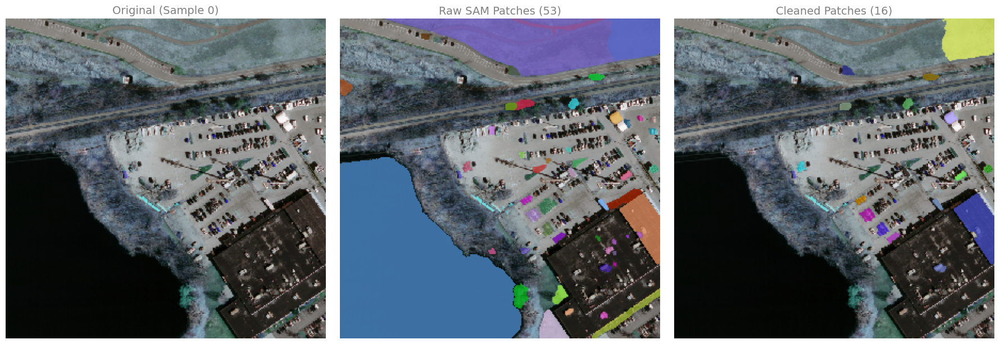

Sample 1: 71 raw patches → 24 cleaned patches


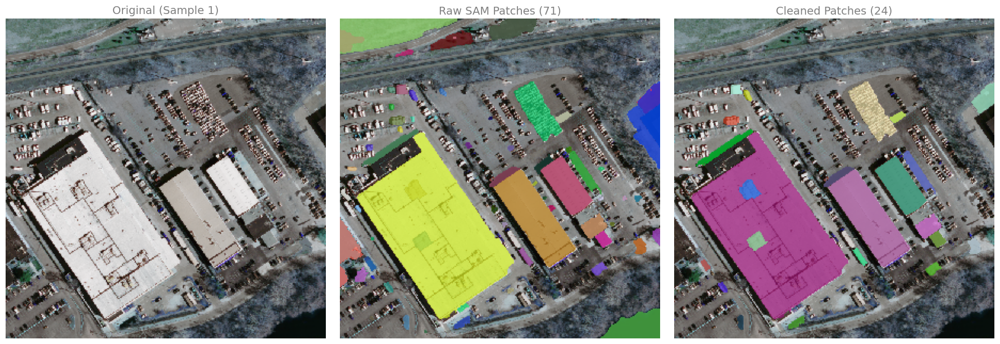

Sample 2: 59 raw patches → 23 cleaned patches


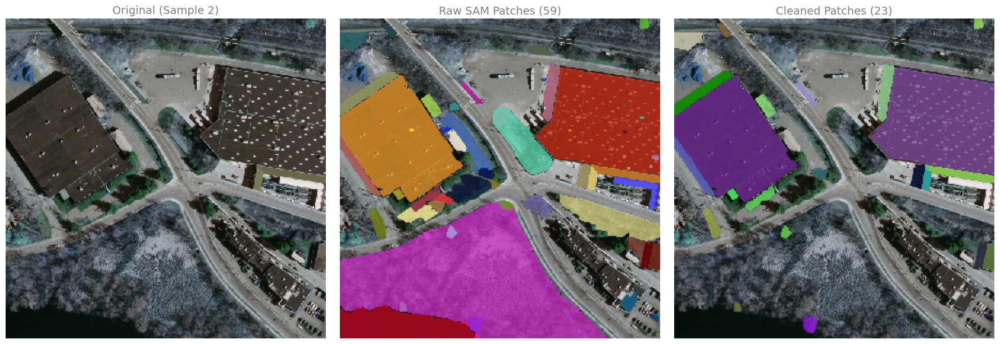

Sample 3: 78 raw patches → 21 cleaned patches


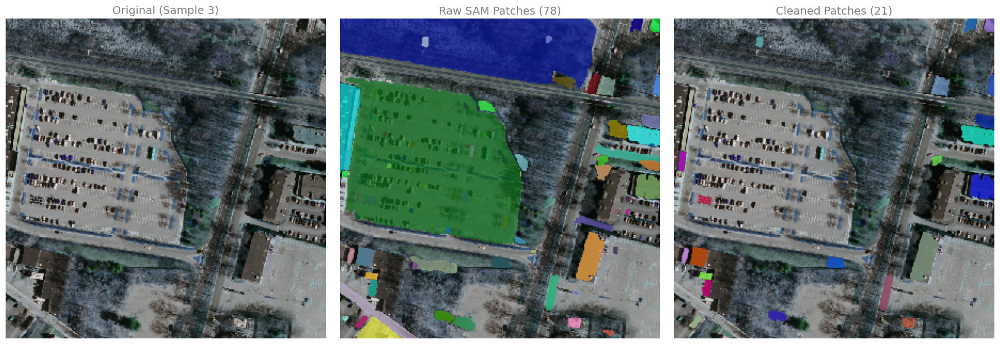

Sample 4: 99 raw patches → 51 cleaned patches


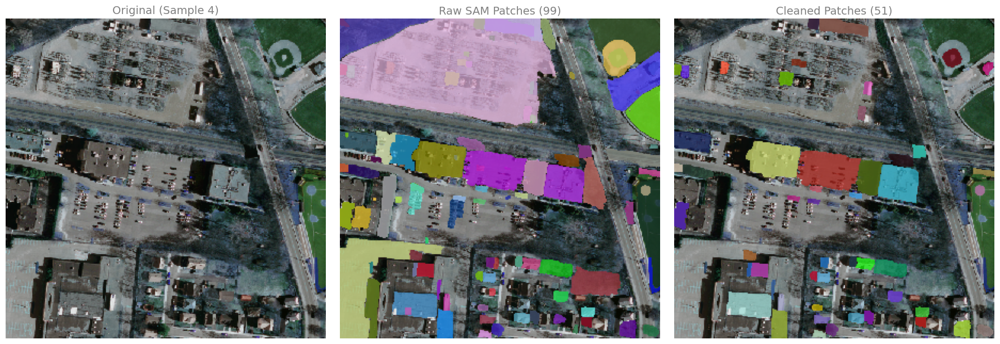

Sample 5: 21 raw patches → 5 cleaned patches


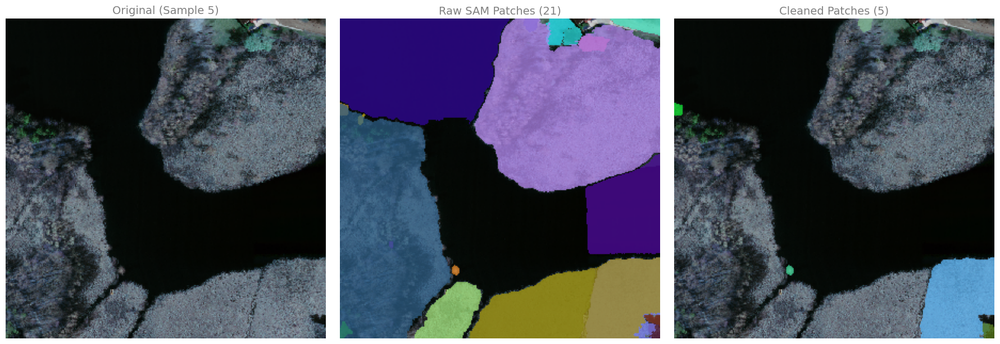

Sample 6: 33 raw patches → 19 cleaned patches


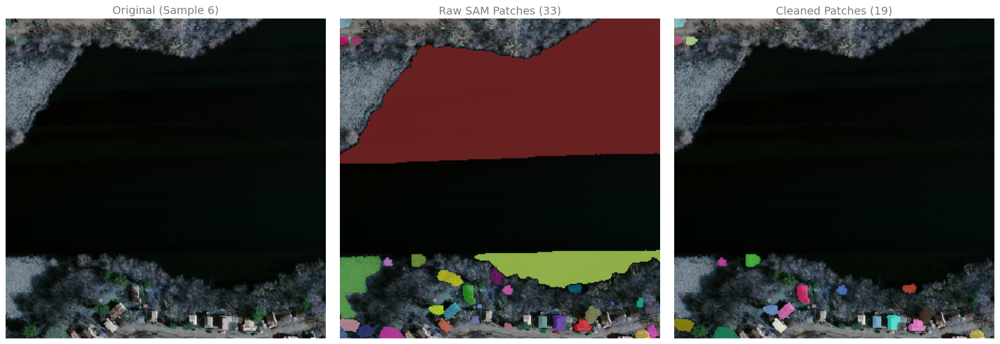

Sample 7: 25 raw patches → 13 cleaned patches


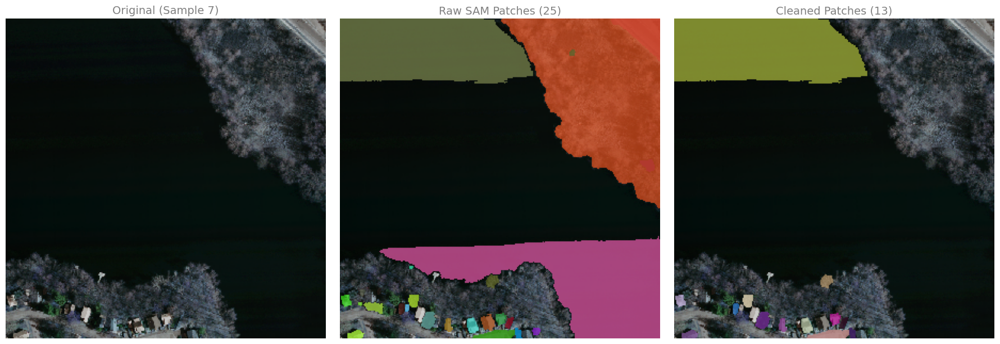

Sample 8: 77 raw patches → 39 cleaned patches


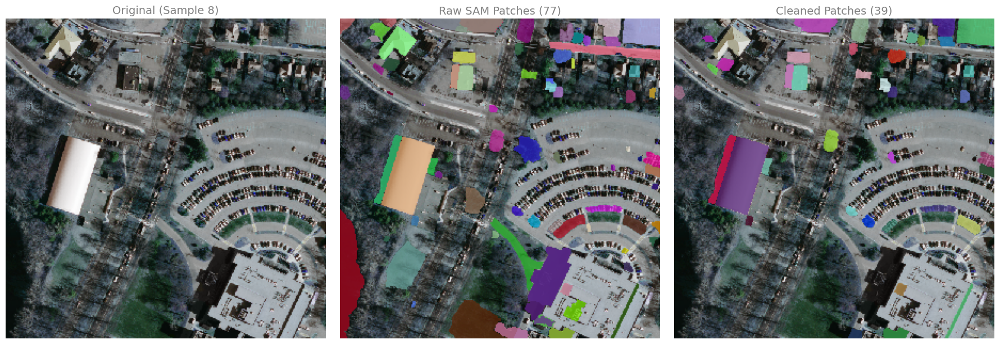

Sample 9: 179 raw patches → 103 cleaned patches


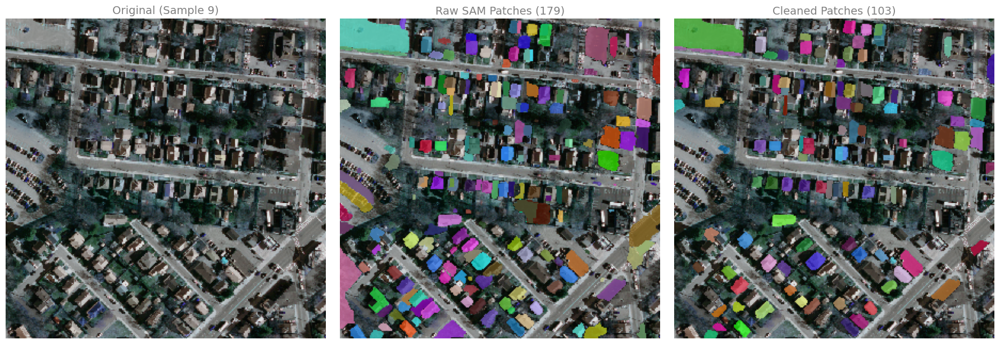

Sample 10: 30 raw patches → 10 cleaned patches


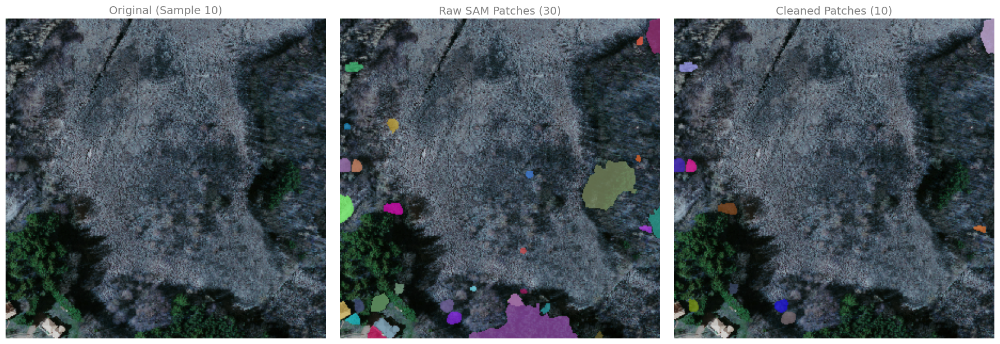

Sample 11: 169 raw patches → 110 cleaned patches


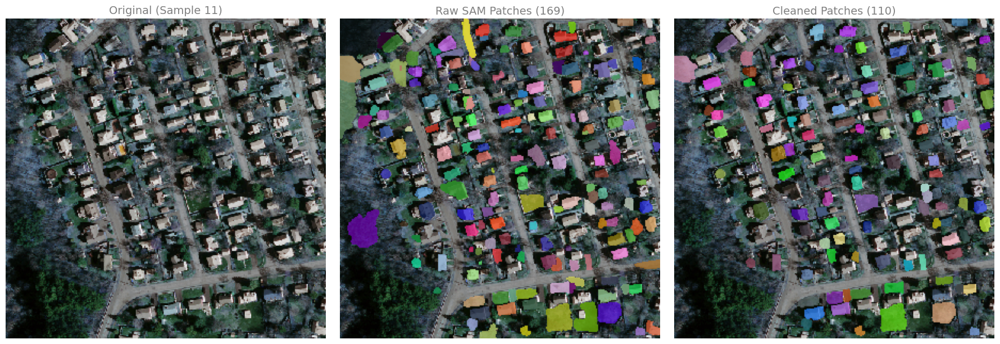

Sample 12: 101 raw patches → 61 cleaned patches


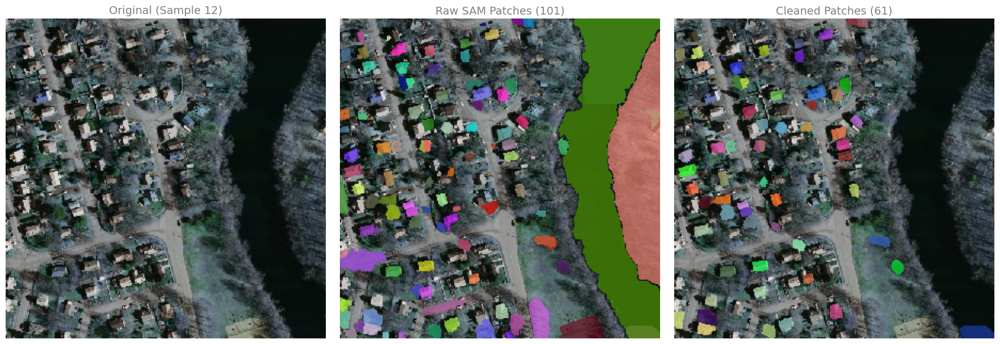

Sample 13: 96 raw patches → 34 cleaned patches


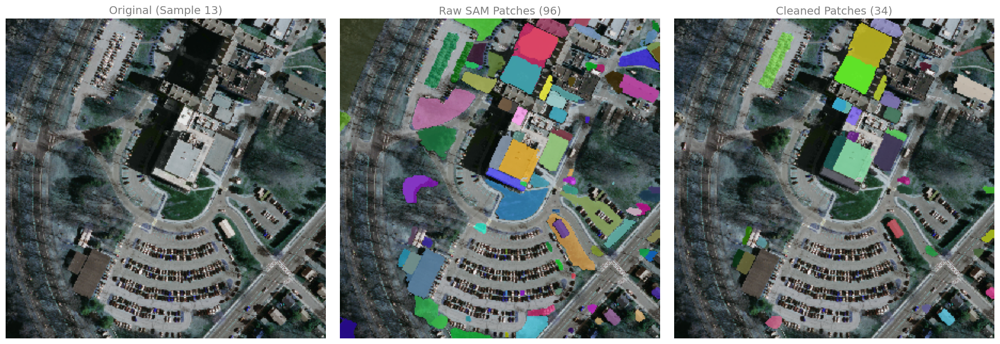

Sample 14: 137 raw patches → 69 cleaned patches


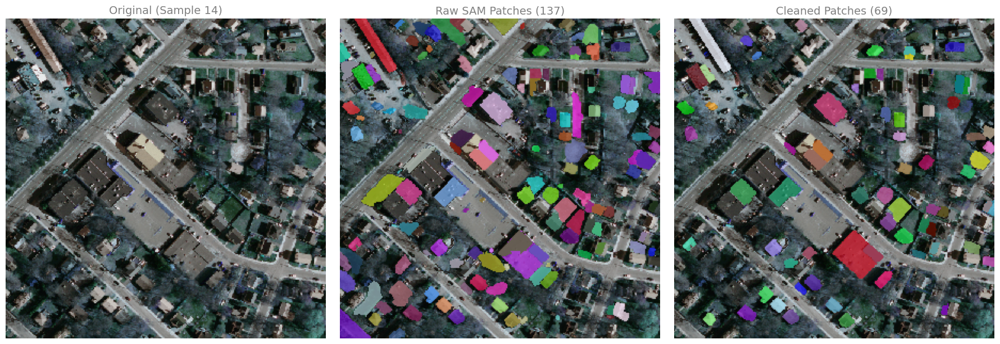

Sample 15: 169 raw patches → 80 cleaned patches


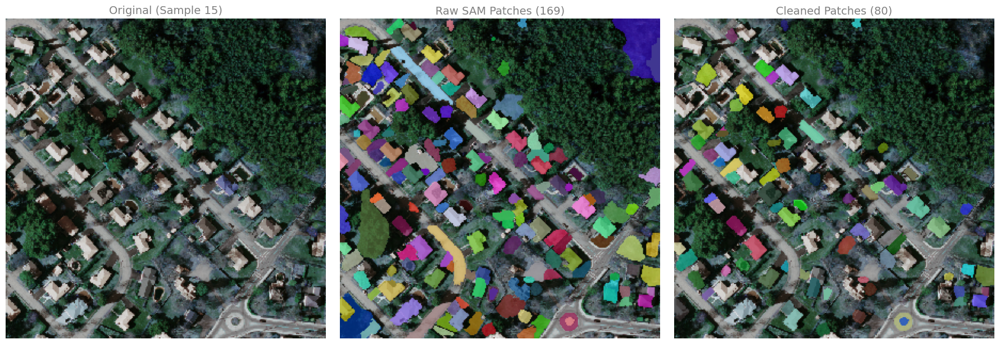

Sample 16: 170 raw patches → 109 cleaned patches


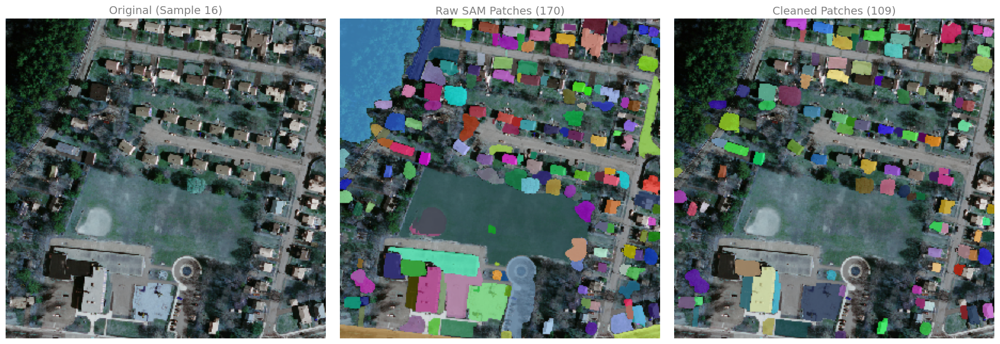

Sample 17: 136 raw patches → 83 cleaned patches


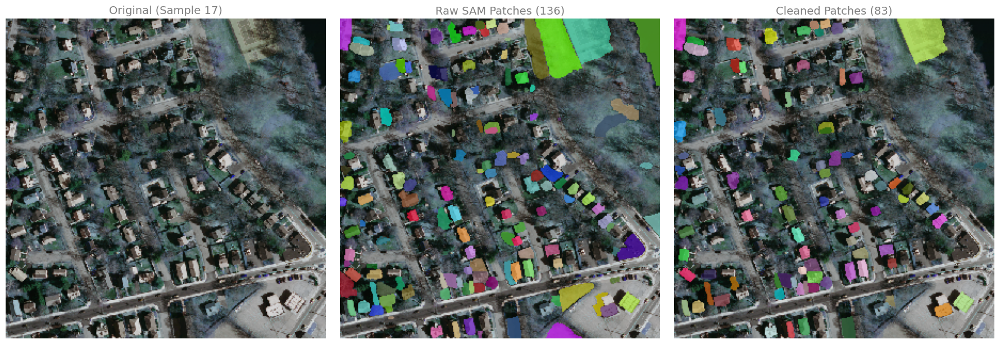

Sample 18: 101 raw patches → 32 cleaned patches


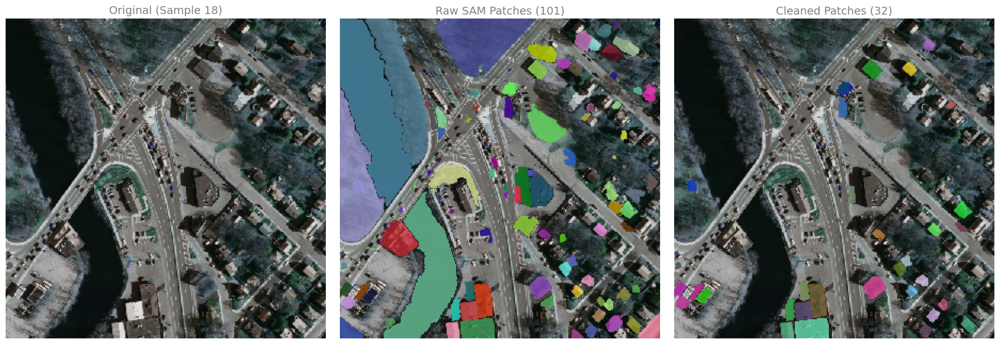

Sample 19: 156 raw patches → 102 cleaned patches


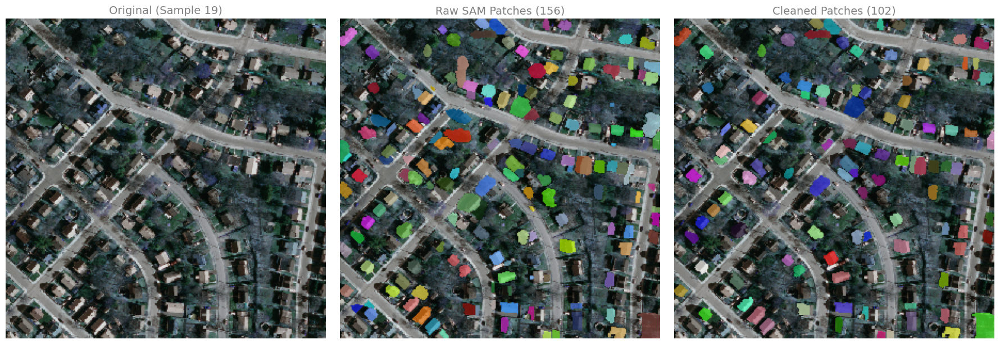

Sample 20: 202 raw patches → 86 cleaned patches


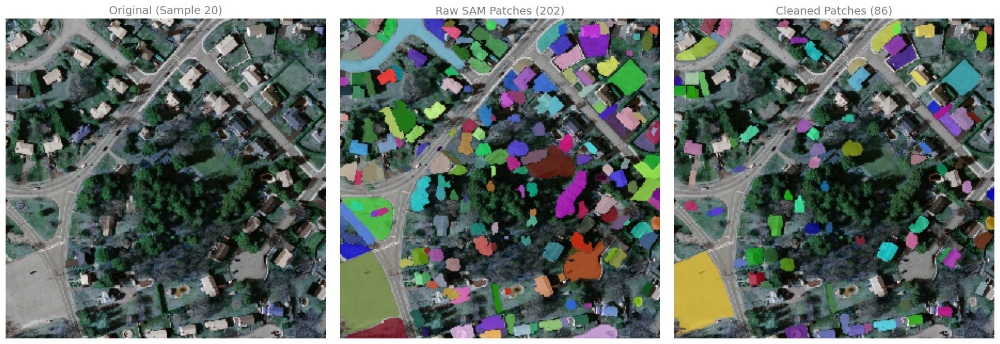

Sample 21: 191 raw patches → 103 cleaned patches


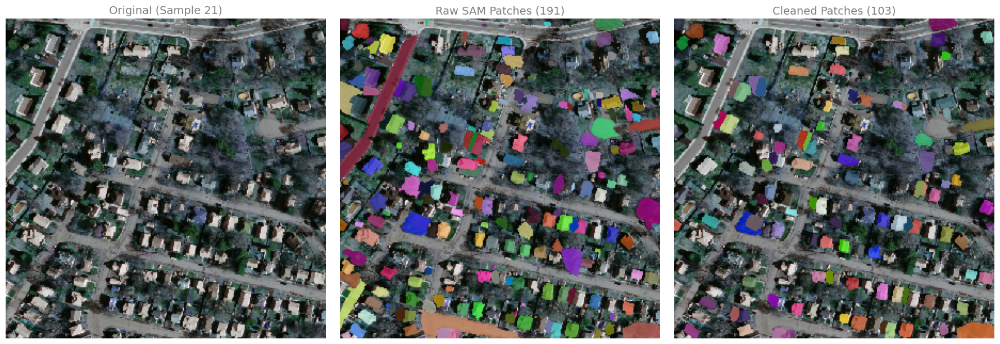

Sample 22: 125 raw patches → 68 cleaned patches


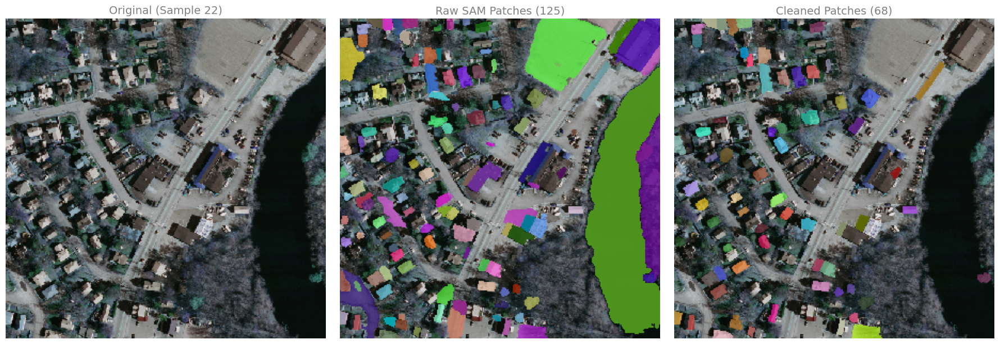

Sample 23: 97 raw patches → 39 cleaned patches


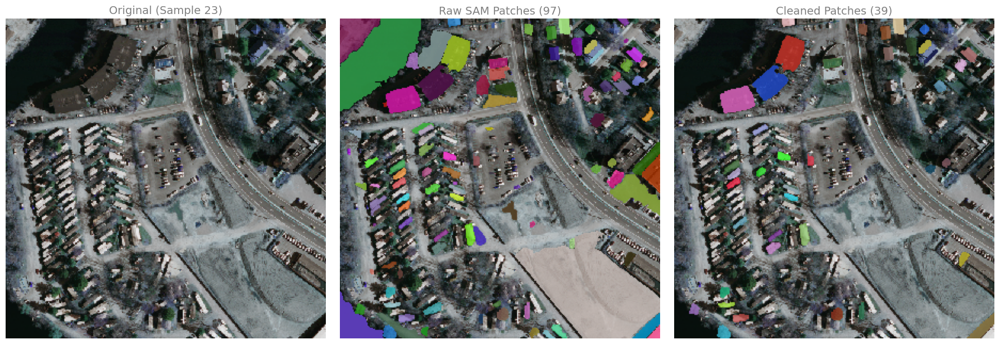

Sample 24: 102 raw patches → 62 cleaned patches


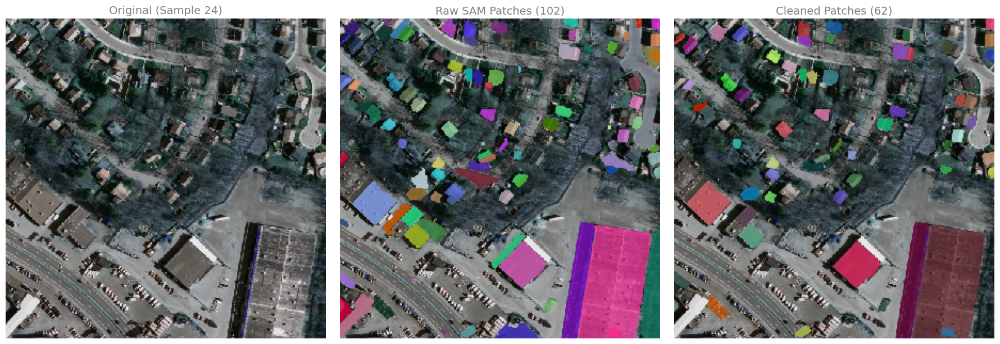

In [28]:
import cv2

for sam_result in sam_results:
    raw_segmentation = sam_result["segmentation"]
    cleaned = clean_segmentation(raw_segmentation)
    sam_result["segmentation_cleaned"] = cleaned
    print(f"Sample {sam_result['index']}: {len(raw_segmentation)} → {len(cleaned)} kept")

# ================================
# Plot all samples: Original | Raw SAM | Cleaned
# ================================
for sam_result in sam_results:
    idx = sam_result["index"]
    img = sam_result["area_rgb"].copy()

    # Overlay raw SAM masks
    overlay_raw = img.copy()
    for patch in sam_result["segmentation"]:
        color = np.random.randint(0, 255, (3,), dtype=np.uint8)
        overlay_raw[patch['segmentation']] = (
            0.3 * overlay_raw[patch['segmentation']] + 0.7 * color
        ).astype(np.uint8)

    # Overlay cleaned SAM masks
    overlay_cleaned = img.copy()
    for patch_cleaned in sam_result["segmentation_cleaned"]:
        color = np.random.randint(0, 255, (3,), dtype=np.uint8)
        overlay_cleaned[patch_cleaned['segmentation']] = (
            0.3 * overlay_cleaned[patch_cleaned['segmentation']] + 0.7 * color
        ).astype(np.uint8)

    # Plot side by side
    print("="*60)
    print(f"Sample {idx}: {len(sam_result['segmentation'])} raw patches → {len(sam_result['segmentation_cleaned'])} cleaned patches")

    plt.figure(figsize=(18,6))
    plt.subplot(1,3,1)
    plt.imshow(img)
    plt.title(f"Original (Sample {idx})")
    plt.axis("off")

    plt.subplot(1,3,2)
    plt.imshow(overlay_raw)
    plt.title(f"Raw SAM Patches ({len(sam_result['segmentation'])})")
    plt.axis("off")

    plt.subplot(1,3,3)
    plt.imshow(overlay_cleaned)
    plt.title(f"Cleaned Patches ({len(sam_result['segmentation_cleaned'])})")
    plt.axis("off")

    plt.show()

# Associating Segmented Patches with Value Map Information

> **Objective:** We now need to associate each segmented patch (in the <u>training</u> set) from SAM with the **corresponding** values in the value map.  

To achieve this, we use a centroid-based nearest-neighbor approach that links every patch to the closest region in the value map.  

## Extract value corresponding to each patch

For each patch produced by SAM:
- The patch **centroid** is computed.  
- All nonzero connected components in the value map are identified and labeled.  
- The centroids of these value-map patches are stored along with their unique values.  
- The **closest value-map patch** to the SAM patch centroid is found.  
- That value is assigned to all pixels of the SAM patch in the attributed map.  

This ensures that every segmentation patch is given the value of the nearest value-map region, enabling meaningful comparison between geometry (segmentation) and content (values).  

<details>
<summary>More details</summary>

1. **Rasterize the SAM patch**  
   - Convert the SAM patch (possibly cropped) into a full-size binary mask `(H, W)` of the original image.  
   - Pixels belonging to the patch are set to `1`, others to `0`.  

2. **Compute the patch centroid**  
   - The centroid is the average `(y, x)` coordinate of all pixels in the patch.  
   - It gives a single representative point for the patch.  

3. **Identify and label nonzero connected components in the value map**  
   - The value map contains regions with positive values (e.g., 5, 10, 15) and background (0).  
   - By thresholding (`value_map > 0`) and running connected-component labeling, we group neighboring nonzero pixels into **separate blobs**.  
   - Each blob gets a unique label, meaning we can treat it as its own region.  

4. **Compute centroids and values of value-map regions**  
   - For each labeled blob, compute its centroid.  
   - Because value maps are quantized, each blob corresponds to a single unique value (e.g., 10).  

5. **Find the nearest value-map region using a KD-tree**  
   - Build a KD-tree of the value-map centroids for efficient lookup.  
   - For each SAM patch centroid, find the closest centroid from the value-map regions.  

6. **Assign the value to the SAM patch**  
   - Take the value of the closest value-map region.  
   - Fill the entire SAM patch with this value in the attributed map.  

This ensures every segmentation patch is associated with the value of the nearest value-map region, linking geometry (segmentation) with content (values).  
</details>


## Visualization

We validate the attribution process by comparing segmentation and values side by side.  
The 3-panel plots show:
1. The original segmentation (patches only).  
2. The original value map (quantized reference values).  
3. The segmentation where each patch is filled with its attributed value.  


In [29]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.measure import regionprops, label
from scipy.spatial import cKDTree

def _to_full_mask(seg, bbox, H, W):
    """Return a full-size boolean mask for a SAM seg using bbox if needed."""
    if seg.shape == (H, W):
        return seg.astype(bool)

    if bbox is None or len(bbox) != 4:
        raise ValueError("Missing or invalid bbox for cropped segmentation.")

    x0, y0, b2, b3 = bbox

    # Case A: [x, y, w, h]
    if y0 + b3 <= H and x0 + b2 <= W and seg.shape == (b3, b2):
        x1, y1 = x0 + b2, y0 + b3
    # Case B: [x0, y0, x1, y1]
    elif b3 <= H and b2 <= W and seg.shape == (b3 - y0, b2 - x0):
        x1, y1 = b2, b3
    else:
        raise ValueError(f"Cannot align bbox {bbox} with seg shape {seg.shape} for image {(H, W)}.")

    full = np.zeros((H, W), dtype=bool)
    full[y0:y1, x0:x1] = seg.astype(bool)
    return full

def attribute_from_value_map(segmentation, value_map):
    """
    For every SAM patch in `segmentation`:
      - find the closest patch in `value_map` (connected component where value_map > 0),
      - read that patch's value,
      - assign it to all pixels of the SAM patch.
    Returns:
      attributed_map  (H, W) float
      labeled_sam     (H, W) int labels for visualization
    """
    H, W = value_map.shape
    labeled_sam = np.zeros((H, W), dtype=np.int32)

    # 1) Rasterize SAM segmentation into labeled_sam
    for i, p in enumerate(segmentation, start=1):
        seg = p["segmentation"]
        bbox = p.get("bbox", None)
        seg_full = _to_full_mask(seg, bbox, H, W)
        labeled_sam[seg_full] = i

    sam_regions = regionprops(labeled_sam)
    if len(sam_regions) == 0:
        return np.zeros((H, W), dtype=float), labeled_sam

    # 2) Label value-map patches (non-zero connected components)
    valued_cc = label(value_map > 0, connectivity=2)
    valued_regions = regionprops(valued_cc)

    if len(valued_regions) == 0:
        # No valued patches available
        return np.zeros((H, W), dtype=float), labeled_sam

    # Precompute centroids and values of each value-map patch
    valued_centroids = np.array([r.centroid for r in valued_regions])
    valued_values = []
    for r in valued_regions:
        coords = tuple(r.coords.T)
        vals = np.unique(value_map[coords])
        vals = vals[vals > 0]
        # Value-map patches are quantized, so this should be a single value
        valued_values.append(float(vals[0]) if len(vals) else 0.0)

    tree = cKDTree(valued_centroids)

    # 3) For each SAM patch, find closest value-map patch and assign its value
    attributed_map = np.zeros((H, W), dtype=float)
    for r in sam_regions:
        _, j = tree.query(r.centroid)
        v = valued_values[j]
        self_mask = (labeled_sam == r.label)
        attributed_map[self_mask] = v

    return attributed_map, labeled_sam

Sample 0


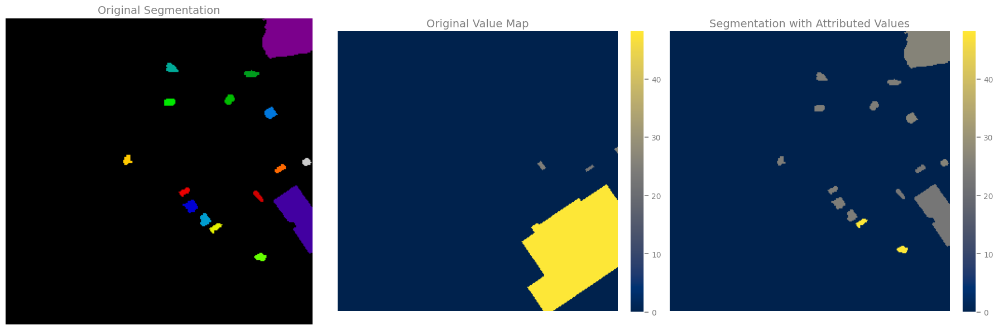

Sample 1


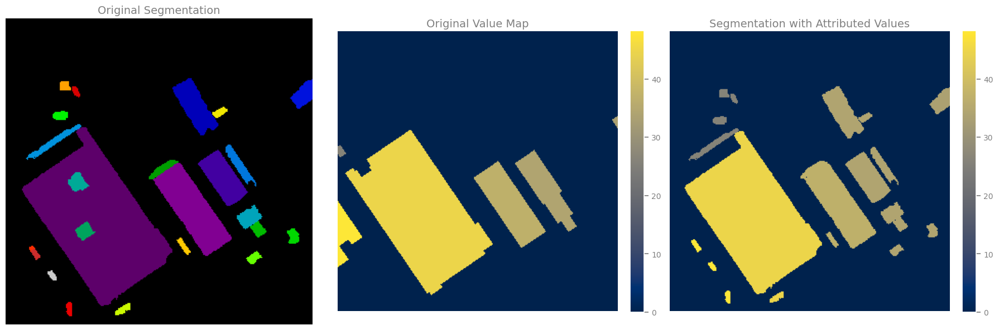

Sample 2


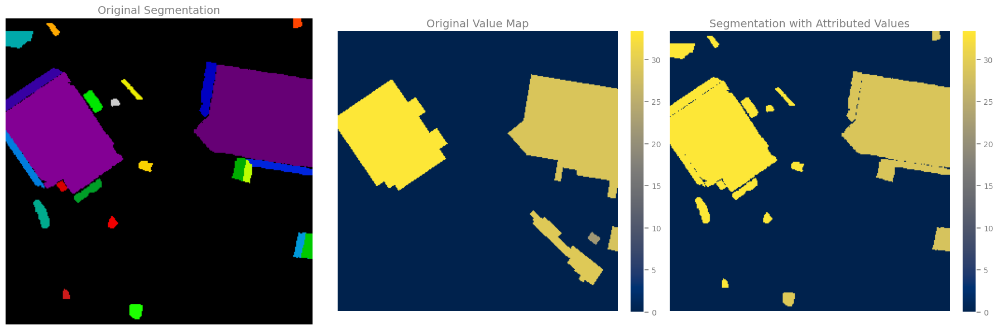

Sample 3


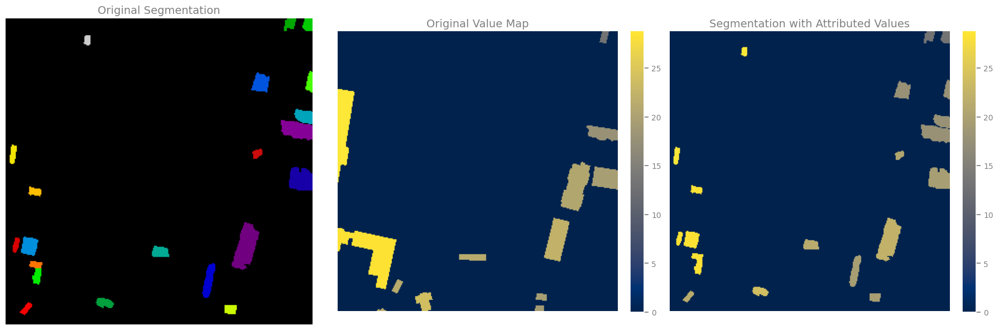

Sample 4


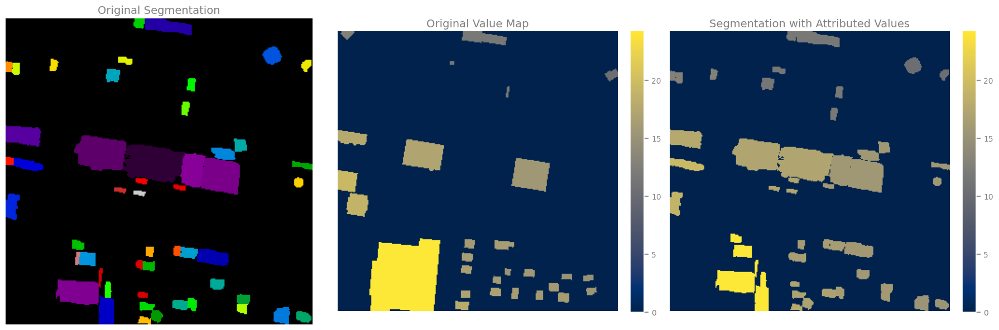

Sample 5


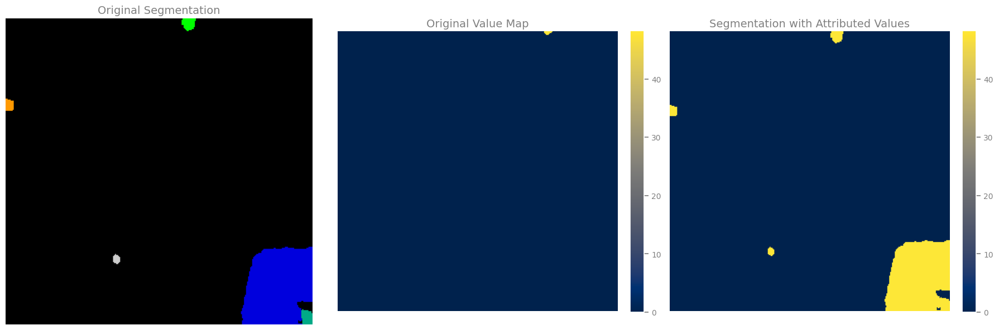

Sample 6


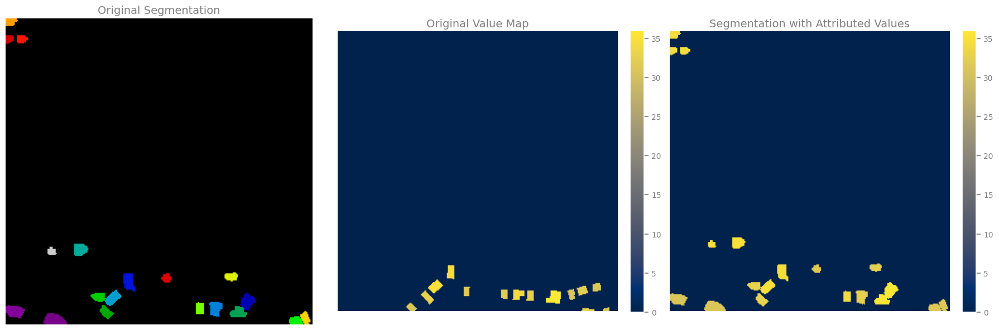

Sample 7


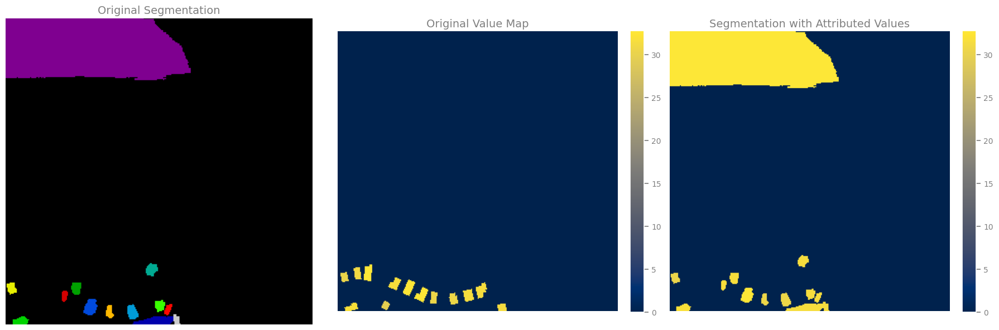

Sample 8


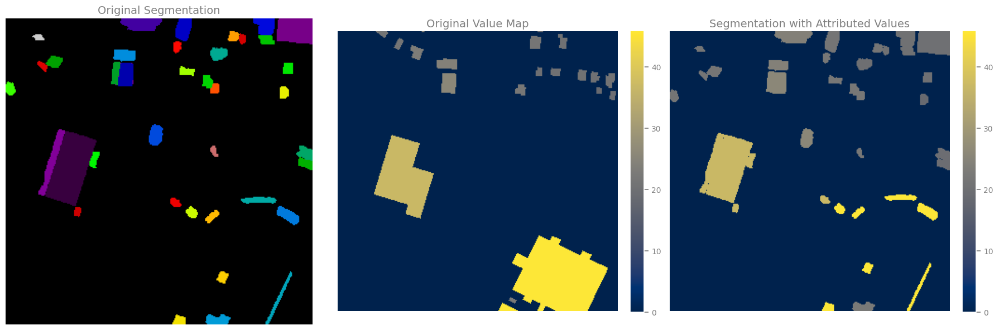

Sample 9


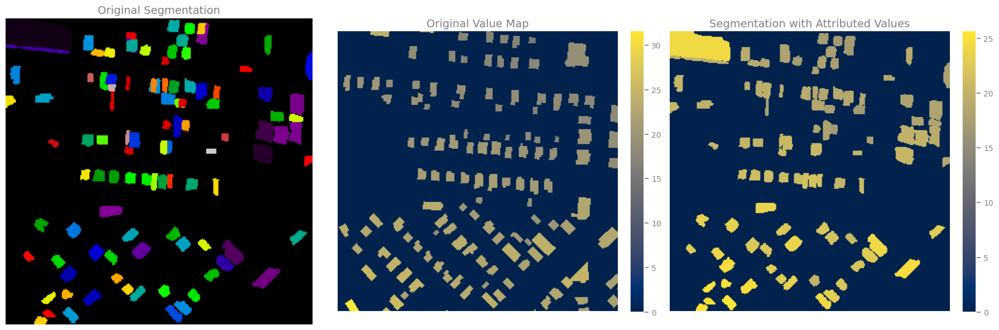

Sample 10


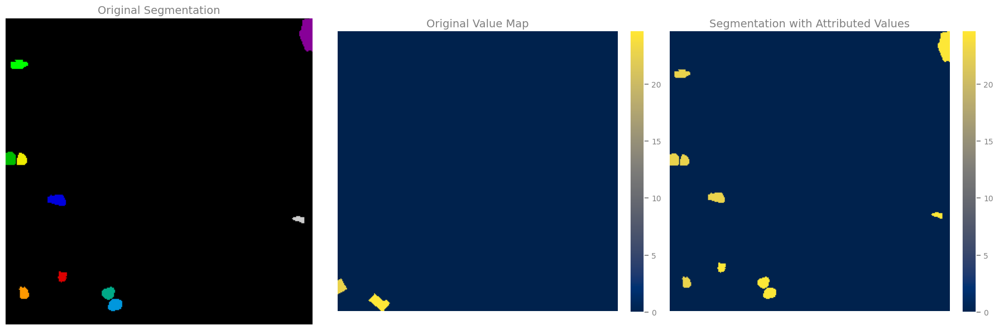

Sample 11


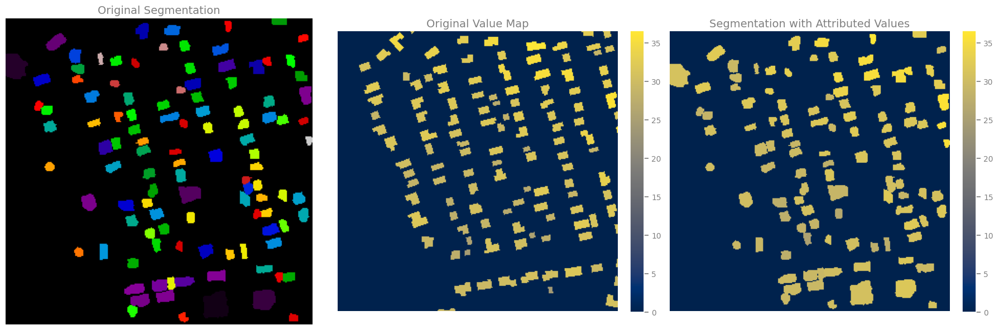

Sample 12


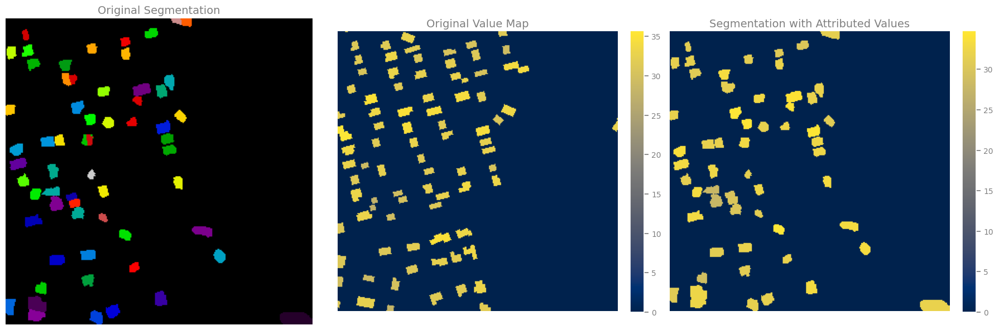

Sample 13


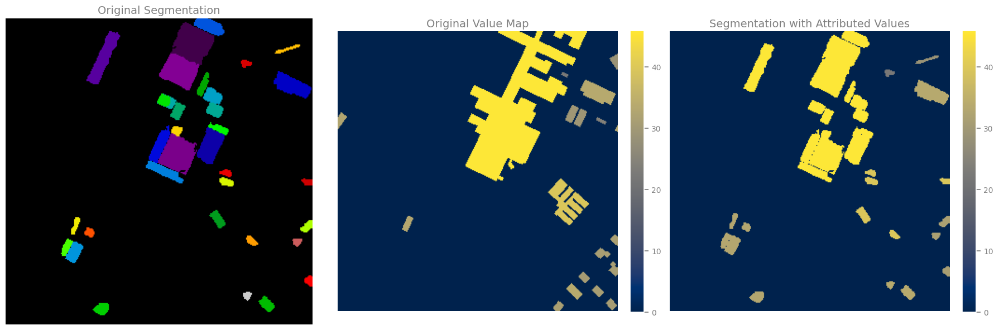

Sample 14


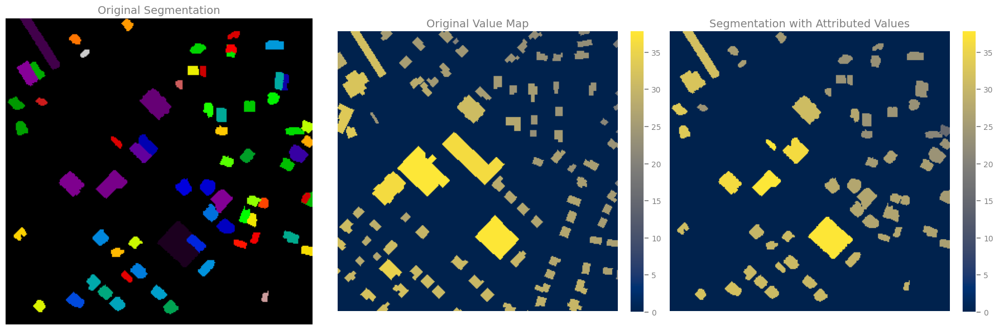

Sample 15


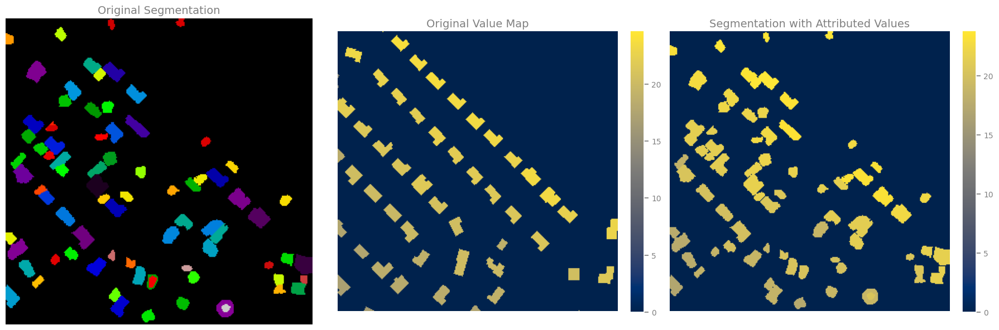

Sample 16


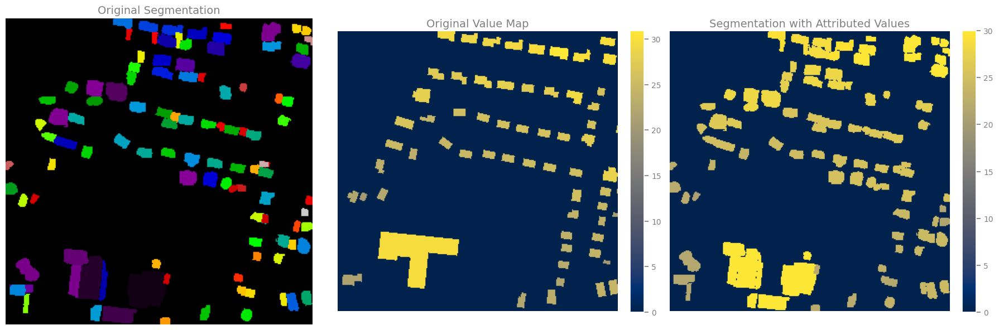

Sample 17


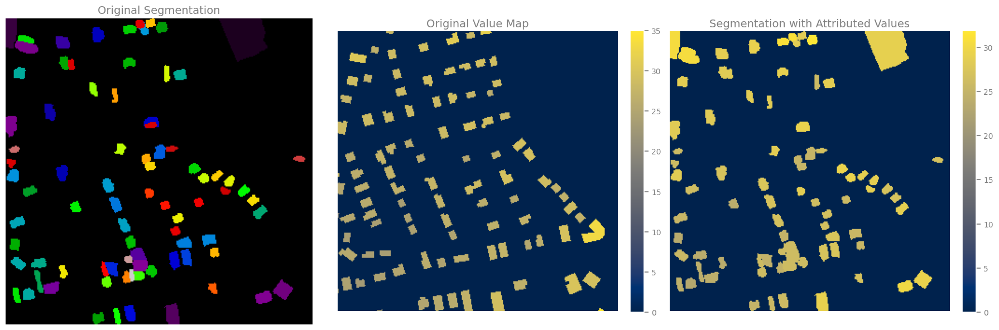

Sample 18


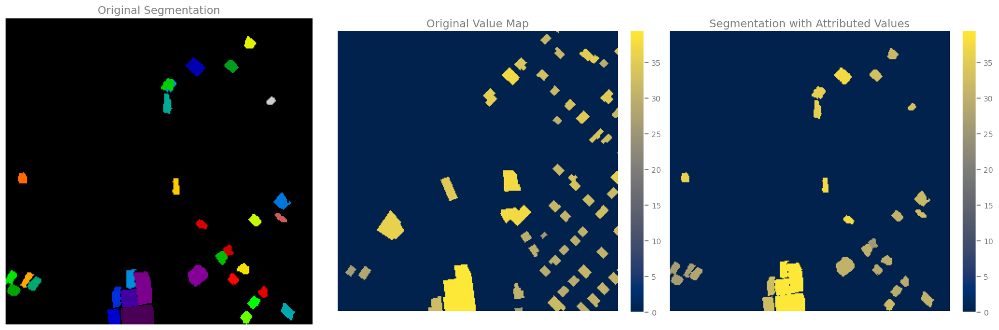

Sample 19


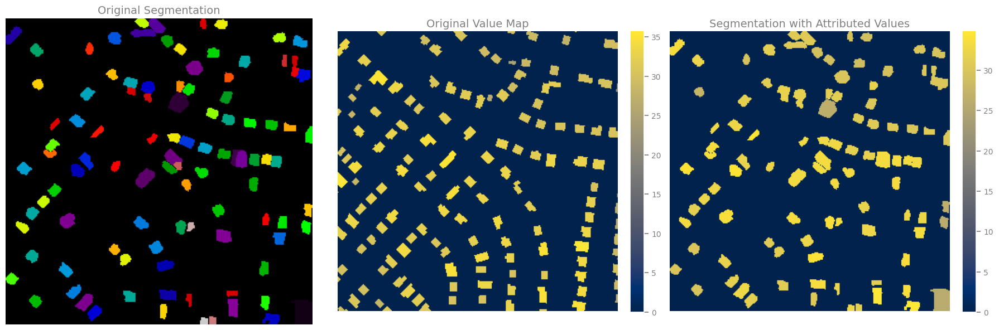

Sample 20


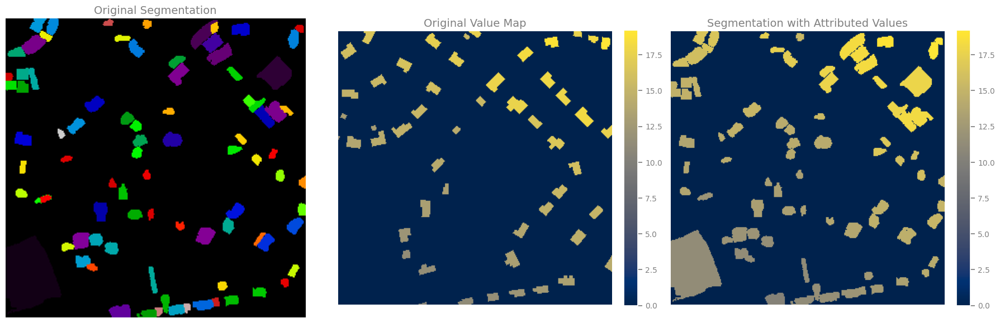

Sample 21


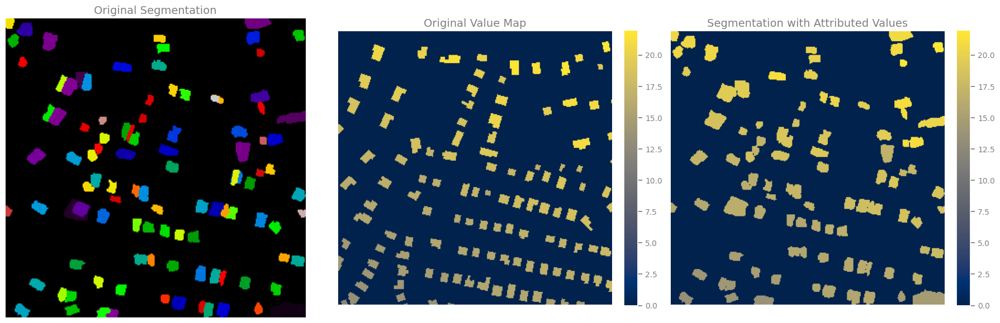

Sample 22


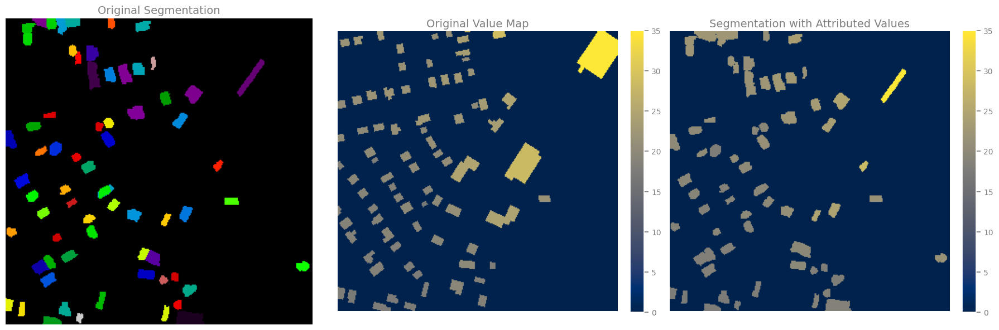

Sample 23


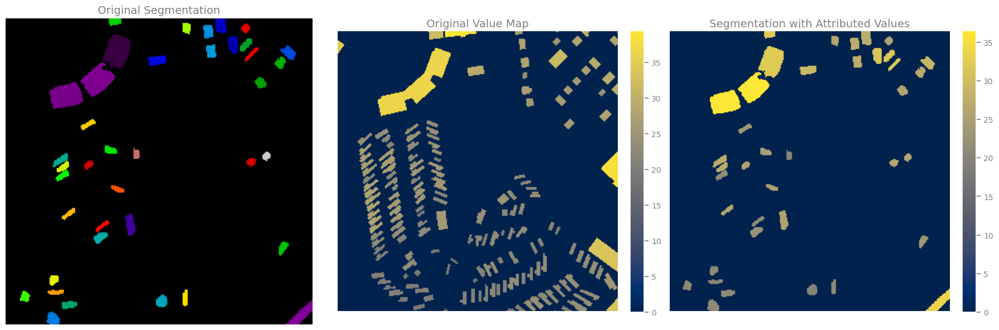

Sample 24


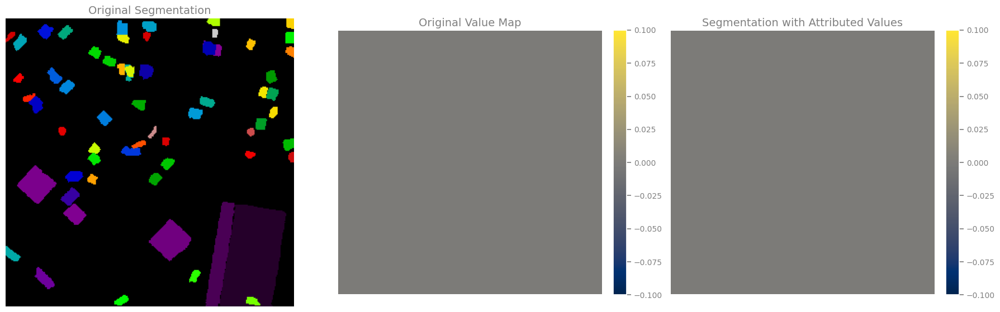

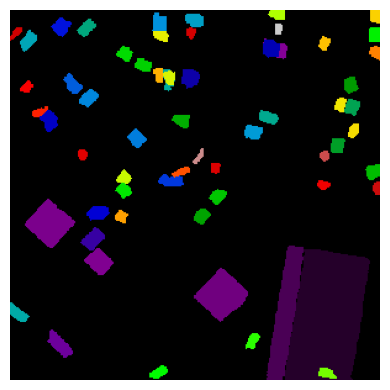

In [74]:
for i, sam_result in enumerate(sam_results):

    idx = sam_result["index"]
    
    print(f"Sample {idx}")
    
    img = sam_result["area_rgb"]
    segmentation_cleaned = sam_result["segmentation_cleaned"]
    
    value_map = X_maps[idx]
    attributed_map, labeled = attribute_from_value_map(segmentation_cleaned, value_map)
    
    # ----------------------------
    # Plot 3-panel comparison
    # ----------------------------
    plt.figure(figsize=(18, 6))
    
    plt.subplot(1, 3, 1)
    plt.imshow(labeled, cmap="nipy_spectral")
    plt.title("Original Segmentation")
    plt.axis("off")
    
    plt.subplot(1, 3, 2)
    plt.imshow(value_map, cmap="cividis")
    plt.title("Original Value Map")
    plt.axis("off")
    plt.colorbar(fraction=0.046, pad=0.04)
    
    plt.subplot(1, 3, 3)
    plt.imshow(attributed_map, cmap="cividis")
    plt.title("Segmentation with Attributed Values")
    plt.axis("off")
    plt.colorbar(fraction=0.046, pad=0.04)
    
    plt.show()
    
    # Export single test mask image
    if i == len(sam_results) - 1:
        plt.figure(figsize=(4, 4))
        plt.imshow(labeled, cmap="nipy_spectral")
        plt.axis("off")
        plt.savefig(os.path.join(path_results, "segmentations.png"), bbox_inches="tight", pad_inches=0)

## Patch-level Feature Extraction

> **Objective:** In this step, the previous findings are converted from **images** and **unstructured data**, to a **tabular** format.  

Each patch from the segmentation is represented as a row in a dataframe, where we record both geometric and value-based descriptors:

`image_ID` `patch_ID` `centroid_x` `centroid_y` `patch_area` `bbox` `value`

This allows us to move from raw image masks to a compact dataset suitable for analysis or modeling.  


In [18]:
import pandas as pd
from skimage.measure import regionprops

records = []

for i, sam_result in enumerate(sam_results):
    idx = sam_result["index"]
    segmentation_cleaned = sam_result["segmentation_cleaned"]
    value_map = X_maps[idx]

    attributed_map, labeled = attribute_from_value_map(segmentation_cleaned, value_map)

    # Extract patch-level properties
    props = regionprops(labeled)
    for p in props:
        records.append({
            "image_ID": idx,
            "patch_ID": p.label,
            "centroid_x": p.centroid[1],    # column coordinate of centroid
            "centroid_y": p.centroid[0],    # row coordinate of centroid
            "patch_area": p.area,           # number of pixels in patch
            "bbox": p.bbox,                 # bounding box (min_row, min_col, max_row, max_col)
            "value": attributed_map[labeled == p.label].mean(),  # avg attributed value
        })

df_segmentations = pd.DataFrame(records)
display(df_segmentations)

df_segmentations.to_csv(os.path.join(path_results, "df_segmentations.csv"), index=False)

,image_ID,patch_ID,centroid_x,centroid_y,patch_area,bbox,value
0,0,1,275.317341,17.991329,1730.0,"(0, 251, 40, 300)",26.183018
1,0,2,285.225078,192.146417,1284.0,"(164, 262, 231, 300)",22.932174
2,0,3,180.732759,183.844828,116.0,"(178, 173, 191, 188)",24.711937
3,0,4,258.295918,92.734694,98.0,"(87, 253, 99, 266)",26.183018
4,0,5,194.343750,197.281250,96.0,"(191, 190, 204, 201)",24.711937
...,...,...,...,...,...,...,...
1357,24,58,4.517241,18.172414,58.0,"(14, 0, 25, 10)",0.000000
1358,24,59,296.857143,144.017857,56.0,"(139, 294, 150, 300)",0.000000
1359,24,60,254.678571,117.767857,56.0,"(114, 251, 123, 259)",0.000000
1360,24,61,152.735849,118.584906,53.0,"(112, 148, 125, 157)",0.000000


## Check number of matched patches

In [75]:
''' _You can use this function to check how many patches you got right in each image_''';
from typing import Tuple
import pandas as pd

def match_pred_gt(
    df_pred: pd.DataFrame,
    df_gt: pd.DataFrame,
    iou_thresh: float = 0.5,
    show_matches=True
):
    """
    Match predicted patches to ground-truth patches using an IoU threshold.

    ----------------------------------------------------------------------
    REQUIRED DATAFRAME FORMAT
    ----------------------------------------------------------------------
    Both df_pred and df_gt must follow the same column structure:

        image_ID      int
        patch_ID      int
        centroid_x    float
        centroid_y    float
        patch_area    float
        bbox          tuple (x1, y1, x2, y2)
        value         float

    Example row format:
        image_ID  patch_ID  centroid_x  centroid_y  patch_area        bbox                    value
        0         1         269.33      146.47      30.0        (143, 265, 151, 275)        22.93
        0         2         217.95      143.60      43.0        (139, 214, 149, 223)        24.71
        0         3         298.13      126.60      15.0        (124, 296, 131, 300)        26.18
        ...
        24        66        254.12      248.19     5642.0       (193, 219, 300, 290)        43.88

    Each row represents a single segmented patch inside an image. The function
    assumes:
    - bbox is a tuple of four integers (x1, y1, x2, y2)
    - coordinates are pixel coordinates within the image
    - image_ID identifies which image the patch belongs to

    ----------------------------------------------------------------------
    FUNCTION DESCRIPTION
    ----------------------------------------------------------------------
    For each ground-truth (GT) patch, the function identifies at most one
    predicted patch (from df_pred) whose bounding box overlaps the GT
    bounding box with IoU >= iou_thresh. Among all candidates, the one
    with the highest IoU is selected.

    The function returns two dataframes:

    1. df_matched:
          - One row per GT patch.
          - Ground truth columns are now prefixed with gt_.
          - Predicted columns are included with their original names
            (NO pred_ prefix anymore).
          - If no prediction matches a GT patch, predicted fields are NaN.

    2. df_pred_matched:
          - Contains only the predicted rows that were successfully matched
            to at least one GT patch.
          - Duplicate predictions (if hypothetically matched multiple times)
            are removed.

    Parameters
    ----------
    df_pred : pd.DataFrame
        Predicted patches following the required row structure above.

    df_gt : pd.DataFrame
        Ground-truth patches following the same row structure.

    iou_thresh : float, optional (default = 0.5)
        Minimum IoU required to consider a prediction a valid match.

    show_matches : bool, optional (default = True)
      Print percentage of matches per image

    Returns
    -------
    df_matched : pd.DataFrame
        One row per GT patch with gt_* fields and predicted fields.

    df_pred_matched : pd.DataFrame
        All predicted rows that matched at least one GT patch, deduplicated.

    Notes
    -----
    - Matching is per image_ID.
    - Each GT patch receives at most one matched prediction.
    - IoU is computed on axis-aligned bounding boxes.
    """;

    keep_pred_cols = ["patch_ID", "centroid_x", "centroid_y", "bbox", "value", "patch_area"]

    def iou(a, b):
        ax1, ay1, ax2, ay2 = a
        bx1, by1, bx2, by2 = b

        ix1, iy1 = max(ax1, bx1), max(ay1, by1)
        ix2, iy2 = min(ax2, bx2), min(ay2, by2)

        iw, ih = max(0, ix2 - ix1), max(0, iy2 - iy1)
        inter = iw * ih
        if inter == 0:
            return 0

        area_a = (ax2 - ax1)*(ay2 - ay1)
        area_b = (bx2 - bx1)*(by2 - by1)
        return inter / (area_a + area_b - inter)

    rows = []
    summary_rows = []
    valid_pred_rows = []

    common_ids = set(df_gt.image_ID.unique()).intersection(df_pred.image_ID.unique())

    for img_id in common_ids:
        gt_img   = df_gt[df_gt.image_ID == img_id]
        pred_img = df_pred[df_pred.image_ID == img_id]

        n_gt   = len(gt_img)
        n_pred = len(pred_img)

        matched_count = 0

        for _, gt_row in gt_img.iterrows():
            gt_box = gt_row["bbox"]
            best = None
            best_score = 0

            for _, pred_row in pred_img.iterrows():
                score = iou(gt_box, pred_row["bbox"])
                if score >= iou_thresh and score > best_score:
                    best = pred_row
                    best_score = score

            if best is not None:
                matched_count += 1
                valid_pred_rows.append(best)

            # --------------------------
            # BUILD MERGED ROW
            # --------------------------
            merged = {}

            # GT columns → prepend gt_
            for col in df_gt.columns:
                merged[f"gt_{col}"] = gt_row[col]

            # Prediction columns → keep original names
            for col in keep_pred_cols:
                merged[col] = None if best is None else best[col]

            rows.append(merged)

        summary_rows.append({
            "image_ID": img_id,
            "n_gt": n_gt,
            "n_pred": n_pred,
            "n_matched": matched_count
        })

    df_summary = pd.DataFrame(summary_rows).sort_values("image_ID")
    df_summary["pct_matched"] = (df_summary["n_matched"] / df_summary["n_gt"] * 100).round(1)

    if show_matches:
        display(df_summary)

    df_matched = pd.DataFrame(rows).reset_index(drop=True)
    df_pred_matched = pd.DataFrame(valid_pred_rows).drop_duplicates().reset_index(drop=True)

    # Undo gt_ prefix for 'image_ID' only (keep others as gt_*)
    df_matched = df_matched.rename(columns={"gt_image_ID": "image_ID"})

    return df_matched, df_pred_matched

In [76]:
_, _ = match_pred_gt(df_segmentations, df_train, show_matches=True)

,image_ID,n_gt,n_pred,n_matched,pct_matched
0,0,4,16,1,25.0
1,1,6,24,2,33.3
2,2,5,23,3,60.0
3,3,13,21,4,30.8
4,4,28,51,12,42.9
5,5,1,5,0,0.0
6,6,14,19,2,14.3
7,7,13,13,4,30.8
8,8,21,39,5,23.8
9,9,127,103,49,38.6


<font size=10> Solution part 2 - Create a regression model </font>

**Tasks:**
Use any regressor to predict the value of a building.

# Train

In [77]:
# Pick features for regression
features = ["image_ID", "centroid_x", "centroid_y", "patch_area"]

In [78]:
# Restrict to actually matched patches
df_train_segmentations, _ = match_pred_gt(df_segmentations, df_train, show_matches=True)

# Dataset of test patches actually found via SAM
df_train_found = df_train_segmentations.dropna()
display(df_train_found)
print('Number of matched patches:', len(df_train_found))  # extra check

,image_ID,n_gt,n_pred,n_matched,pct_matched
0,0,4,16,1,25.0
1,1,6,24,2,33.3
2,2,5,23,3,60.0
3,3,13,21,4,30.8
4,4,28,51,12,42.9
5,5,1,5,0,0.0
6,6,14,19,2,14.3
7,7,13,13,4,30.8
8,8,21,39,5,23.8
9,9,127,103,49,38.6


,image_ID,gt_patch_ID,gt_centroid_x,gt_centroid_y,gt_patch_area,gt_bbox,gt_value,patch_ID,centroid_x,centroid_y,bbox,value,patch_area
0,0,1,269.333333,146.466667,30.0,"(143, 265, 151, 275)",22.932174,13.0,268.017544,147.105263,"(143, 263, 152, 274)",22.932174,57.0
7,1,4,183.868746,185.360864,2918.0,"(139, 146, 232, 223)",36.967405,2.0,182.316298,186.837017,"(142, 144, 233, 221)",36.967405,2896.0
8,1,5,87.802162,193.851142,13046.0,"(106, 8, 283, 166)",44.782236,1.0,89.949389,199.683705,"(107, 16, 282, 163)",44.782236,11875.0
11,2,2,295.234742,223.150235,213.0,"(209, 289, 236, 300)",28.345799,12.0,294.963303,223.844037,"(211, 289, 236, 300)",28.345799,218.0
12,2,3,250.649451,103.153823,9836.0,"(46, 182, 179, 300)",28.857531,1.0,248.502727,96.265508,"(46, 184, 146, 300)",28.857531,8802.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1343,23,121,197.175676,13.094595,74.0,"(8, 194, 20, 202)",27.502707,11.0,197.631579,12.798246,"(7, 193, 20, 203)",27.502707,114.0
1345,23,123,200.152941,32.988235,85.0,"(28, 196, 39, 205)",27.689616,12.0,200.486239,32.266055,"(26, 196, 39, 206)",27.689616,109.0
1349,23,127,274.772727,33.772727,88.0,"(28, 269, 41, 282)",28.688593,9.0,276.312000,33.600000,"(27, 268, 41, 284)",28.688593,125.0
1351,23,129,147.443750,41.925000,160.0,"(37, 139, 48, 157)",29.270744,8.0,147.641379,41.193103,"(37, 139, 47, 157)",29.270744,145.0


Number of matched patches: 503


In [79]:
%%time
# ================================
# Hyperparameter tuning with RandomizedSearchCV
# ================================
import pandas as pd
import numpy as np
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.model_selection import RandomizedSearchCV
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
# from sklearn.ensemble import RandomForestRegressor  # WARNING: Cannot extrapolate very well, and image is at the corner!
from sklearn.neural_network import MLPRegressor


# -------------------------------------------------------
# GridDecomposer: converts image_ID → (row, col) indices
# Top-left = ID 0 = (0,0), then increases row-wise.
# Example: ID=0→(0,0), ID=1→(0,1), ID=2→(0,2), ..., ID=24→(4,4)
# Result is appended to remaining features.
# -------------------------------------------------------
class GridDecomposer(BaseEstimator, TransformerMixin):
    def __init__(self, H=5, W=5):
        self.H = H
        self.W = W

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        ids = X["image_ID"].to_numpy()

        row = ids // self.W     # vertical index
        col = ids % self.W      # horizontal index

        X_rest = X.drop(columns=["image_ID"]).to_numpy()
        return np.column_stack([row, col, X_rest])

# -------------------------------------------------------
# Prepare features/labels
# -------------------------------------------------------
X_train = df_train_found[features]
y_train = df_train_found["value"]

# -------------------------------------------------------
# Pipeline definition (grid decomposition → scaling → MLP)
# -------------------------------------------------------
pipeline = Pipeline([
    ("grid", GridDecomposer(H=5, W=5)),
    ("scaler", StandardScaler()),
    ("regressor", MLPRegressor(max_iter=1000, random_state=42)),
])

# -------------------------------------------------------
# Hyperparameter search space (reasonable for MLPRegressor)
# -------------------------------------------------------
param_dist = {
    "regressor__hidden_layer_sizes": [
        (32,), (64,), (128,),
        (64, 32), (128, 64),
        (128, 64, 32)
    ],
    "regressor__solver": ["adam"],
    "regressor__activation": ["relu", "tanh"],
    "regressor__alpha": [1e-5, 1e-4, 1e-3, 1e-2],
    "regressor__learning_rate": ["constant", "adaptive"],
}

# -------------------------------------------------------
# Randomized search with refit
# -------------------------------------------------------
random_search = RandomizedSearchCV(
    pipeline, param_distributions=param_dist,
    n_iter=10, scoring="r2", cv=5, n_jobs=-1,
    random_state=42, verbose=10, refit=True
)

# -------------------------------------------------------
# Fit search
# -------------------------------------------------------
random_search.fit(X_train, y_train)

# -------------------------------------------------------
# Report results
# -------------------------------------------------------
print("✅ Best parameters:")
print(random_search.best_params_)
print()
print("✅ Best cross-validation R²:")
print(f"{random_search.best_score_:.3f}")

Fitting 5 folds for each of 10 candidates, totalling 50 fits


/media/work/software/miniconda3/envs/hackaton/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:781: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/media/work/software/miniconda3/envs/hackaton/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:781: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/media/work/software/miniconda3/envs/hackaton/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:781: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
/media/work/software/miniconda3/envs/hackaton/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:781: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached 

✅ Best parameters:
{'regressor__solver': 'adam', 'regressor__learning_rate': 'adaptive', 'regressor__hidden_layer_sizes': (128,), 'regressor__alpha': 0.001, 'regressor__activation': 'tanh'}

✅ Best cross-validation R²:
0.295
CPU times: user 1.31 s, sys: 30.3 ms, total: 1.34 s
Wall time: 8.32 s


/media/work/software/miniconda3/envs/hackaton/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:781: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


# Performance on train

Train set performance:
✅ MSE: 4.125
✅ R² : 0.897


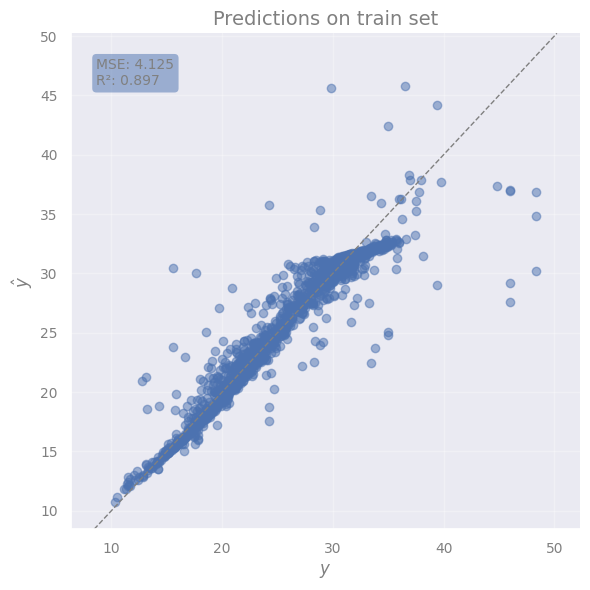

In [80]:
from sklearn.metrics import mean_squared_error, r2_score

# ================================
# Evaluate best model on TRUE train set
# ================================

X_train = df_train[features]
y_train = df_train["value"]

# Predict with best estimator
yhat_train = random_search.predict(X_train)

# Report performance
mse_train = mean_squared_error(y_train, yhat_train)
r2_train = r2_score(y_train, yhat_train)

print("Train set performance:")
print(f"✅ MSE: {mse_train:.3f}")
print(f"✅ R² : {r2_train:.3f}")

# ================================
# Plot
# ================================

fig = plt.figure(figsize=(6,6))
plt.scatter(y_train, yhat_train, c='C0', alpha=0.5)

xmin, xmax = plt.xlim()
plt.ylim(xmin, xmax)

plt.plot([xmin, xmax], [xmin, xmax], ls='--', lw=1, c='grey')

plt.title("Predictions on train set")
plt.xlabel(r"$y$")
plt.ylabel(r"$\hat{y}$")

plt.text(
    0.05, 0.95,
    f"MSE: {mse_train:.3f}\nR²: {r2_train:.3f}",
    transform=plt.gca().transAxes,
    va="top", ha="left",
    bbox=dict(boxstyle="round", fc="C0", ec="none", alpha=0.5)
)

plt.tight_layout()
plt.show()


# Export model

In [93]:
import joblib
joblib.dump(random_search, os.path.join(path_results, "model.pkl"))

['results/model.pkl']

# Final assessment

This is not possible for the participants, since they do not have the test set.

It only serves as our **reference score**.

In [82]:
import numpy as np
from typing import List, Optional, Dict, Any

def rasterize_segmentations(
    seg_list: List[Dict[str, Any]],
    patch_ids: Optional[List[int]] = None
) -> np.ndarray:
    """
    Rasterize a list of segmentation outputs into a single labeled image.

    Each entry in seg_list must contain:
        seg['segmentation']  a boolean mask (H x W)

    The function assigns to each mask the value of its patch index
    (or the provided patch_ids), and returns a single (H x W) integer array.

    Parameters
    ----------
    seg_list : list of dict
        Each dict must include:
            segmentation : np.ndarray of shape (H, W), bool
        All masks must share the same shape.

    patch_ids : list of int, optional
        Patch IDs to burn into the raster. Must match len(seg_list) if given.
        If None, the function uses indices 1..N.

    Returns
    -------
    np.ndarray
        Integer raster (H x W) containing zero for background and the patch ID
        for each pixel belonging to that mask.

    Notes
    -----
    Overlapping masks are resolved by the order in seg_list
    (later masks overwrite earlier ones).
    """
    if len(seg_list) == 0:
        raise ValueError("seg_list is empty.")

    H, W = seg_list[0]["segmentation"].shape
    raster = np.zeros((H, W), dtype=int)

    if patch_ids is None:
        patch_ids = list(range(1, len(seg_list) + 1))

    for pid in patch_ids:
        idx = pid - 1
        if idx < 0 or idx >= len(seg_list):
            raise ValueError(f"patch ID {pid} exceeds segmentation list length.")
        raster[seg_list[idx]["segmentation"]] = pid

    return raster


In [83]:
import numpy as np
from typing import List, Optional, Dict, Any

def rasterize_values(
    seg_list: List[Dict[str, Any]],
    patch_ids: Optional[List[int]] = None,
    patch_values: Optional[List[int]] = None
) -> np.ndarray:
    """
    Rasterize segmentation masks using either patch_ids or patch_values.

    If patch_values is supplied, it must match the length of patch_ids.
    Each patch_id in patch_ids receives the corresponding value in patch_values.
    Only masks whose index matches a patch_id are rasterized.
    """

    if len(seg_list) == 0:
        raise ValueError("seg_list is empty.")

    H, W = seg_list[0]["segmentation"].shape
    raster = np.zeros((H, W), dtype=int)

    # Default patch_ids
    if patch_ids is None:
        patch_ids = list(range(1, len(seg_list) + 1))

    # Check values
    if patch_values is not None:
        if len(patch_values) != len(patch_ids):
            raise ValueError("patch_values must match length of patch_ids.")
        value_map = dict(zip(patch_ids, patch_values))
    else:
        value_map = {pid: pid for pid in patch_ids}

    # Burn values
    for pid in patch_ids:
        idx = pid - 1
        if idx < 0 or idx >= len(seg_list):
            raise ValueError(f"patch ID {pid} exceeds segmentation list length.")
        mask = seg_list[idx]["segmentation"]
        raster[mask] = value_map[pid]

    return raster


In [85]:
# === Load the bundle ===
with open("data/bundle_assessment.pkl", "rb") as f:
    bundle_assessment = pickle.load(f)

# Test set
X_test_msk = bundle_assessment["X_test_msk"]
X_test_map = bundle_assessment["X_test_map"]
df_test    = bundle_assessment["df_test"]

In [86]:
# Percentage matched
df_test_segmentations, df_segmentations_test = match_pred_gt(df_segmentations, df_test, show_matches=True)

# Dataset of test patches actually found via SAM
df_test_found = df_test_segmentations.dropna()
display(df_test_found)
print('Number of matched patches:', len(df_test_found))  # extra check

,image_ID,n_gt,n_pred,n_matched,pct_matched
0,24,66,62,25,37.9


,image_ID,gt_patch_ID,gt_centroid_x,gt_centroid_y,gt_patch_area,gt_bbox,gt_value,patch_ID,centroid_x,centroid_y,bbox,value,patch_area
11,24,12,14.222222,23.777778,81.0,"(18, 8, 31, 21)",29.003814,21.0,14.422535,24.436620,"(16, 8, 34, 22)",0.0,142.0
15,24,16,49.385417,60.656250,96.0,"(53, 43, 68, 57)",29.383640,15.0,50.371622,59.804054,"(51, 43, 68, 59)",0.0,148.0
18,24,19,90.255319,147.765957,141.0,"(140, 83, 157, 99)",29.568044,35.0,91.888889,145.814815,"(140, 85, 153, 99)",0.0,108.0
20,24,21,152.713178,166.038760,129.0,"(159, 145, 174, 161)",29.612884,29.0,155.099174,166.694215,"(161, 149, 174, 163)",0.0,121.0
22,24,23,31.448000,89.080000,125.0,"(81, 25, 99, 39)",29.639626,11.0,31.556213,89.224852,"(81, 24, 99, 39)",0.0,169.0
23,24,24,167.439655,150.241379,116.0,"(145, 160, 158, 176)",29.714239,32.0,168.151261,150.672269,"(145, 161, 158, 176)",0.0,119.0
24,24,25,62.462264,71.122642,106.0,"(65, 56, 79, 70)",29.737445,17.0,63.435374,70.891156,"(64, 56, 79, 72)",0.0,147.0
25,24,26,150.076923,117.096154,104.0,"(110, 144, 125, 156)",29.755266,61.0,152.735849,118.584906,"(112, 148, 125, 157)",0.0,53.0
27,24,28,91.852273,34.545455,88.0,"(29, 86, 41, 99)",30.051692,34.0,92.725664,35.008850,"(29, 86, 42, 100)",0.0,113.0
32,24,33,60.445455,14.172727,110.0,"(7, 54, 22, 68)",31.086413,25.0,61.671756,14.015267,"(7, 54, 22, 70)",0.0,131.0


Number of matched patches: 25


Test set performance:
✅ MSE: 1.912
✅ R² : 0.789


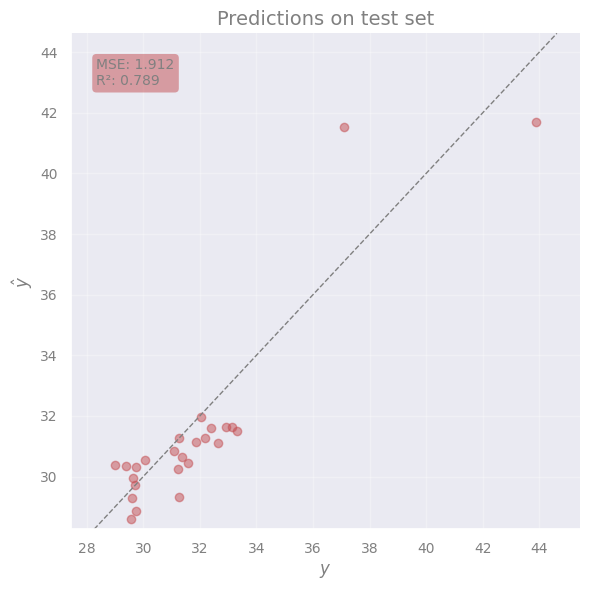

In [87]:
from sklearn.metrics import mean_squared_error, r2_score

# ================================
# Evaluate best model on test set
# ================================

X_test = df_test_found[features]
y_test = df_test_found["gt_value"]  # <-- ground truth value

# Predict with best estimator
yhat_test = random_search.predict(X_test)

# Report performance
mse_test = mean_squared_error(y_test, yhat_test)
r2_test = r2_score(y_test, yhat_test)

print("Test set performance:")
print(f"✅ MSE: {mse_test:.3f}")
print(f"✅ R² : {r2_test:.3f}")

# ================================
# Plot
# ================================

fig = plt.figure(figsize=(6,6))
plt.scatter(y_test, yhat_test, c='C3', alpha=0.5)

xmin, xmax = plt.xlim()
plt.ylim(xmin, xmax)

plt.plot([xmin, xmax], [xmin, xmax], ls='--', lw=1, c='grey')

plt.title("Predictions on test set")
plt.xlabel(r"$y$")
plt.ylabel(r"$\hat{y}$")

plt.text(
    0.05, 0.95,
    f"MSE: {mse_test:.3f}\nR²: {r2_test:.3f}",
    transform=plt.gca().transAxes,
    va="top", ha="left",
    bbox=dict(boxstyle="round", fc="C3", ec="none", alpha=0.5)
)

plt.tight_layout()
plt.show()


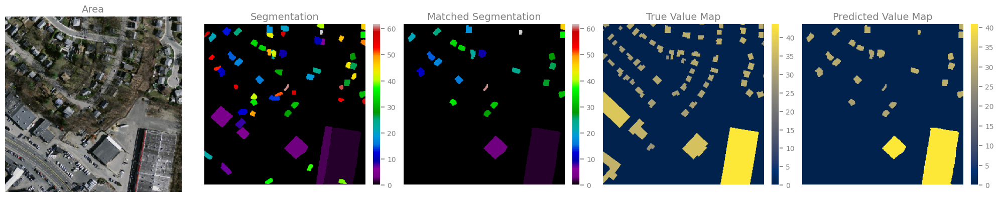

In [91]:
# IDs of segmented patches which have been matched to the ground truth
matched_patches_IDs = df_test_found['patch_ID'].values.astype(int)

# Segmentations for test set
X_test_cleaned = sam_results[-1]['segmentation_cleaned']

# Rasterize SAM segmentation into labeled mask
labeled_cleaned = rasterize_segmentations(X_test_cleaned)

# Rasterize matched SAM segmentation into labeled mask
labeled_cleaned_matched = rasterize_segmentations(X_test_cleaned, patch_ids=matched_patches_IDs)

# Rasterize matched SAM segmentation predicted values
value_test_hat = rasterize_values(X_test_cleaned, patch_ids=matched_patches_IDs, patch_values=yhat_test)

# ----------------------------
# Plot 3-panel comparison
# ----------------------------
plt.figure(figsize=(20, 6))

plt.subplot(1, 5, 1)
plt.imshow(X_test_area)
plt.title("Area")
plt.axis("off")

plt.subplot(1, 5, 2)
plt.imshow(labeled_cleaned, cmap="nipy_spectral")
plt.title("Segmentation")
plt.axis("off")
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(1, 5, 3)
plt.imshow(labeled_cleaned_matched, cmap="nipy_spectral")
plt.title("Matched Segmentation")
plt.axis("off")
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(1, 5, 4)
plt.imshow(X_test_map, cmap="cividis")
plt.title("True Value Map")
plt.axis("off")
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(1, 5, 5)
plt.imshow(value_test_hat, cmap="cividis")
plt.title("Predicted Value Map")
plt.axis("off")
plt.colorbar(fraction=0.046, pad=0.04)

plt.show()

In [21]:
#EOF

In [22]:
#EOF